# 0. Importing dependencies & Downloading data

In [1]:
from google.colab import drive

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from torchvision import datasets, transforms
import torchvision.models as models
from torchvision.transforms import v2
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.tensorboard import SummaryWriter

import numpy as np

import pandas as pd

import cv2

from scipy.stats import entropy, skew
from sklearn.cluster import KMeans
from skimage import io, color

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import plotly.express as px

import os
import json
from tqdm import tqdm
import math
import random
import pickle
from PIL import Image

if torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

%load_ext tensorboard

DATA_DIR = 'house_plant_species/Tulip'

In [2]:
drive.mount('/content/drive')

%cd /content/drive/MyDrive/dominant-color-recognition

Mounted at /content/drive
/content/drive/MyDrive/dominant-color-recognition


In [ ]:
!kaggle datasets download kacpergregorowicz/house-plant-species

In [ ]:
!unzip house-plant-species.zip

# 1. Data Analysis

## Plotting images

In [ ]:
def plot_images(images, num_cols=5):
    num_images = len(images)
    num_rows = (num_images // num_cols) + int(num_images % num_cols != 0)

    plt.figure(figsize=(15, 3 * num_rows))
    for i, img in enumerate(images):
        plt.subplot(num_rows, num_cols, i + 1)
        plt.imshow(img)
        plt.axis('off')
    plt.tight_layout()
    plt.show()


In [ ]:
def load_images_from_folder(folder_path, num_images=10):
    images = []
    image_files = [f for f in os.listdir(folder_path) if f.endswith(('.png', '.jpg', '.jpeg'))]

    for img_file in image_files[:num_images]:
        img_path = os.path.join(folder_path, img_file)
        image = Image.open(img_path).convert("RGB")
        images.append(image)

    return images

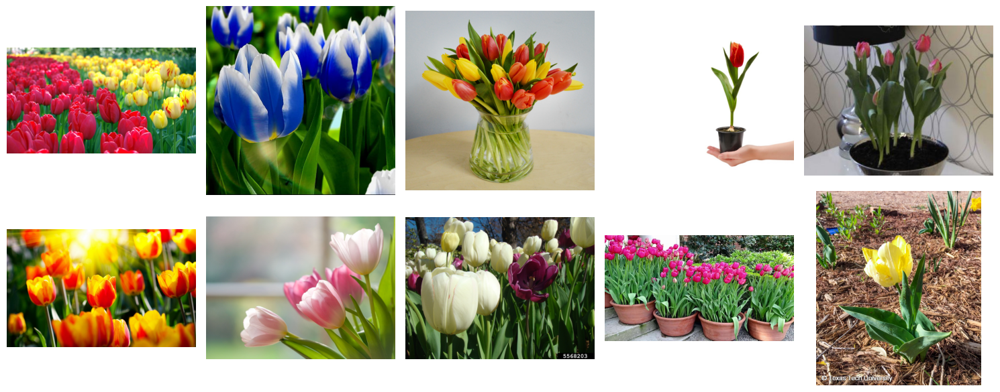

In [ ]:
images = load_images_from_folder(DATA_DIR)
plot_images(images, num_cols=5)

## 1.1 Contrast & [Colorfulness](https://pyimagesearch.com/2017/06/05/computing-image-colorfulness-with-opencv-and-python/)

In [ ]:
def compute_color_contrast(image):
    # Convert to grayscale
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    contrast = gray_image.std()  # Standard deviation of grayscale
    return contrast

def compute_colorfulness(image):
    (B, G, R) = cv2.split(image.astype("float"))

    # Compute rg = R - G and yb = 0.5 * (R + G) - B
    rg = np.absolute(R - G)
    yb = np.absolute(0.5 * (R + G) - B)

    # Compute the mean and standard deviation of both `rg` and `yb`
    (rbMean, rbStd) = (np.mean(rg), np.std(rg))
    (ybMean, ybStd) = (np.mean(yb), np.std(yb))

    # Combine the mean and standard deviations to calculate colorfulness
    stdRoot = np.sqrt((rbStd ** 2) + (ybStd ** 2))
    meanRoot = np.sqrt((rbMean ** 2) + (ybMean ** 2))

    # Derive the "colorfulness" metric
    colorfulness = stdRoot + (0.3 * meanRoot)
    return colorfulness

def calculate_average_contrast_colorfulness(image_dir):
    # Get the image paths from the directory
    image_paths = [os.path.join(image_dir, f) for f in os.listdir(image_dir) if f.lower().endswith(('jpg', 'jpeg', 'png', 'bmp', 'tiff'))]

    contrasts = []
    colorfulness_values = []

    # Calculate contrast and colorfulness for each image
    for image_path in image_paths:
        image = cv2.imread(image_path)
        contrast = compute_color_contrast(image)
        colorfulness_metric = compute_colorfulness(image)

        contrasts.append(contrast)
        colorfulness_values.append(colorfulness_metric)

    # Calculate the average and standard deviation for contrast and colorfulness
    avg_contrast = np.mean(contrasts)
    std_contrast = np.std(contrasts)

    avg_colorfulness = np.mean(colorfulness_values)
    std_colorfulness = np.std(colorfulness_values)

    return avg_contrast, std_contrast, avg_colorfulness, std_colorfulness

In [ ]:
contrast, contrast_std, colorfulness, colorfulness_std = calculate_average_contrast_colorfulness(DATA_DIR)

print(f'Average contrast is {contrast} (sigma = {contrast_std})')
print(f'Average colorfulness is {colorfulness} (sigma = {colorfulness_std})')

Average contrast is 55.10934822994104 (sigma = 12.173317764750179)
Average colorfulness is 69.98475672948112 (sigma = 25.67819220551329)


The contrast is average, and the standard deviation indicates that some images have more and some less contrast.\
The average colorfulness is high, which means that the images in our dataset contain a lot of different colors. It also has a higher standard deviation, which means that our images vary in colorfulness. It could also be because some images are with solid color backgrounds.

## 1.2 [Color Entropy](https://unimatrixz.com/blog/latent-space-image-quality-with-entropy/)

In [ ]:
def compute_color_entropy(image, bins=128):
    # Convert the image to grayscale
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    hist, _ = np.histogram(gray_image.ravel(), bins=bins, range=(0, bins))

    prob_dist = hist / hist.sum()
    image_entropy = entropy(prob_dist, base=2)
    return image_entropy

def calculate_average_color_entropy(image_dir, bins=128):
    # Get the image paths in the directory
    image_paths = [os.path.join(image_dir, f) for f in os.listdir(image_dir) if f.lower().endswith(('jpg', 'jpeg', 'png', 'bmp', 'tiff'))]

    entropies = []

    # Calculate entropy for each image
    for image_path in image_paths:
        image = cv2.imread(image_path)
        entropy = compute_color_entropy(image, bins)

        entropies.append(entropy)

    # Calculate the average and standard deviation of entropy values
    avg_entropy = np.mean(entropies)
    std_entropy = np.std(entropies)

    return avg_entropy, std_entropy


In [ ]:
entropy, entropy_std = calculate_average_color_entropy(DATA_DIR)

print(f'Average entropy is {entropy} (sigma = {entropy_std})')

Average entropy is 6.4676129129428865 (sigma = 0.5359666725118141)


Entropy in our case measures variations, i.e. surprises in the pixel distribution and is measured in values ​​0-8. 6.47 is a higher entropy, which indicates that within the average image we have a relatively complex and diverse color distribution. A standard deviation of about 0.54 indicates that some images have more complex color distributions than others, but this difference is not overly large.

## 1.3 [CDF - Cumulative Distribution Function](https://medium.com/image-processing-with-python/image-enhancement-with-python-d3040a39e394)

In [ ]:
def compute_cdf(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    hist, bins = np.histogram(gray_image.flatten(), bins=256, range=[0, 256])
    cdf = hist.cumsum()  # Cumulative sum
    cdf_normalized = cdf / cdf[-1]  # Normalize to range [0, 1]
    return cdf_normalized

def plot_image_and_cdf(image, image_path):
    cdf = compute_cdf(image)

    plt.figure(figsize=(8, 4))

    # Plot the image
    plt.subplot(1, 2, 1)  # 1 row, 2 columns, first subplot
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))  # Convert from BGR to RGB for display
    plt.title(f'Image: {os.path.basename(image_path)}')
    plt.axis('off')

    # Plot the CDF
    plt.subplot(1, 2, 2)  # 1 row, 2 columns, second subplot
    plt.plot(cdf, color='blue', label=f'CDF of {os.path.basename(image_path)}')
    plt.title(f'Cumulative Distribution Function (CDF)')
    plt.xlabel('Pixel Intensity')
    plt.ylabel('Cumulative Probability')
    plt.grid(True)
    plt.legend()

    plt.tight_layout()
    plt.show()

def compute_cdf_metrics(image):
    cdf = compute_cdf(image)

    # Calculate percentiles
    p25 = np.percentile(cdf, 25)
    p50 = np.percentile(cdf, 50)
    p75 = np.percentile(cdf, 75)

    # Calculate contrast (dynamic range)
    contrast = np.max(cdf) - np.min(cdf)

    # Calculate skewness (asymmetry of the intensity distribution)
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    image_skewness = skew(gray_image.flatten())

    return p25, p50, p75, contrast, image_skewness

def calculate_average_cdf_metrics(image_dir, num_images=10):
    # Get the image paths in the directory
    image_paths = [os.path.join(image_dir, f) for f in os.listdir(image_dir) if f.lower().endswith(('jpg', 'jpeg', 'png', 'bmp', 'tiff'))]

    percentiles_25 = []
    percentiles_50 = []
    percentiles_75 = []
    contrasts = []
    skewnesses = []

    # Calculate the metrics for each image
    for idx, image_path in enumerate(image_paths):

        image = cv2.imread(image_path)

        if idx < num_images:
          plot_image_and_cdf(image, image_path)

        # Calculate CDF metrics
        p25, p50, p75, contrast, image_skewness = compute_cdf_metrics(image)

        percentiles_25.append(p25)
        percentiles_50.append(p50)
        percentiles_75.append(p75)
        contrasts.append(contrast)
        skewnesses.append(image_skewness)

    # Calculate the average and standard deviation for each metric
    avg_p25 = np.mean(percentiles_25)
    avg_p50 = np.mean(percentiles_50)
    avg_p75 = np.mean(percentiles_75)
    avg_contrast = np.mean(contrasts)
    avg_skewness = np.mean(skewnesses)

    std_p25 = np.std(percentiles_25)
    std_p50 = np.std(percentiles_50)
    std_p75 = np.std(percentiles_75)
    std_contrast = np.std(contrasts)
    std_skewness = np.std(skewnesses)

    return avg_p25, avg_p50, avg_p75, avg_contrast, avg_skewness, std_p25, std_p50, std_p75, std_contrast, std_skewness

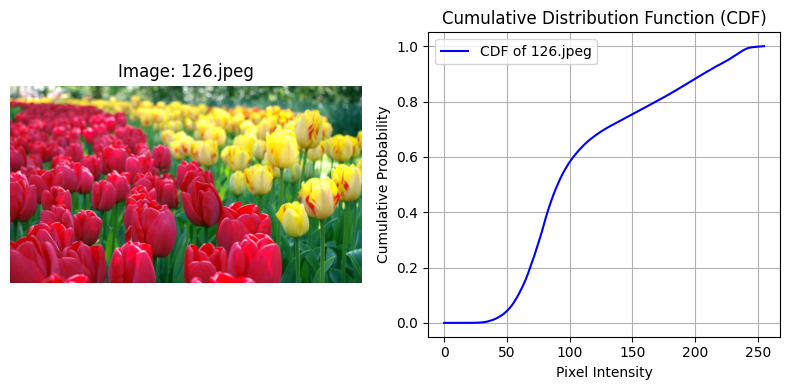

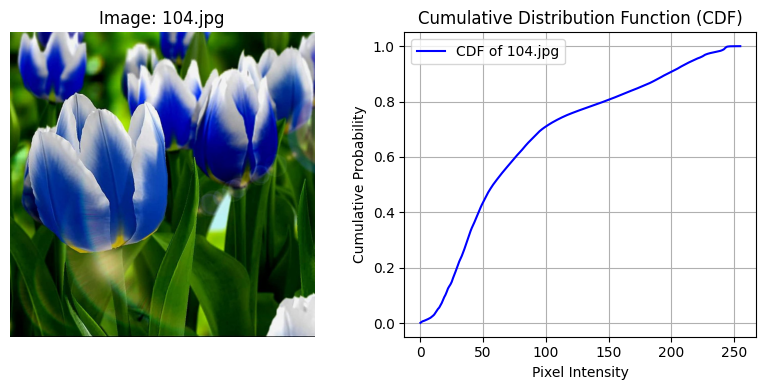

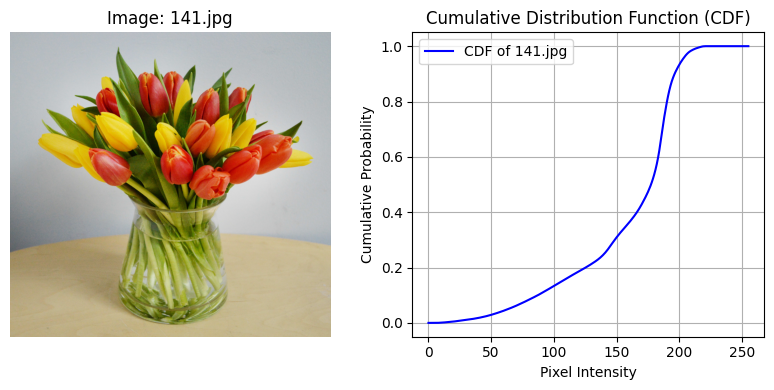

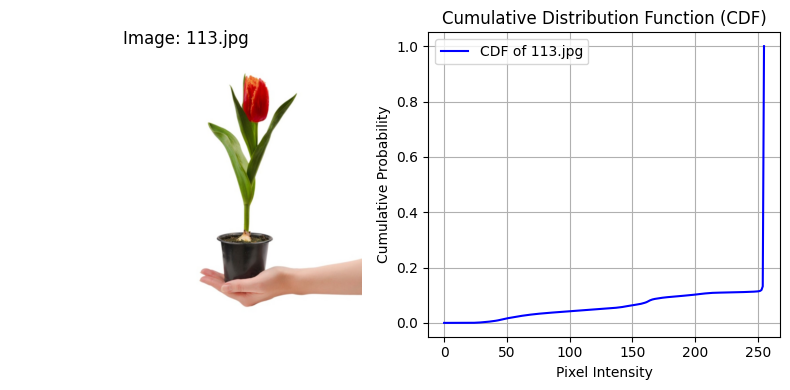

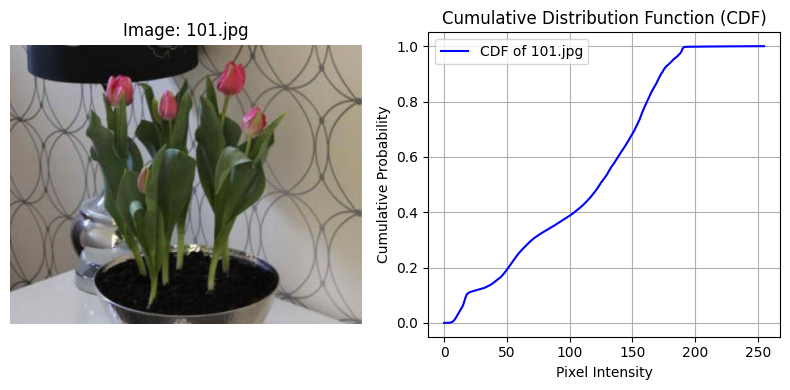

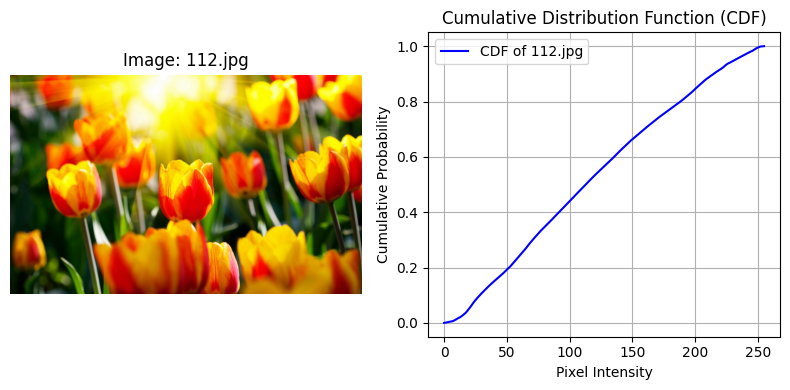

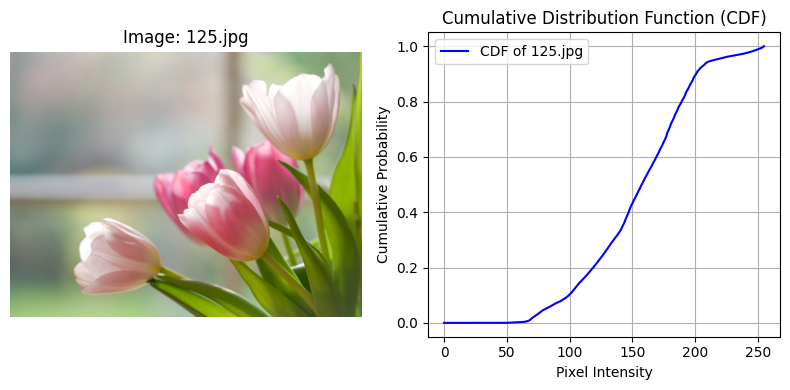

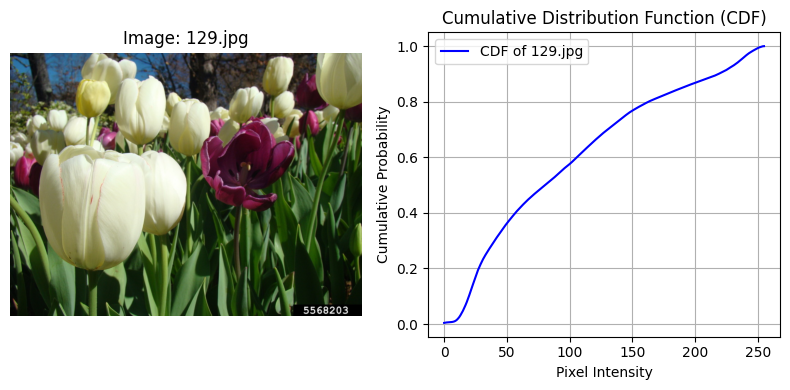

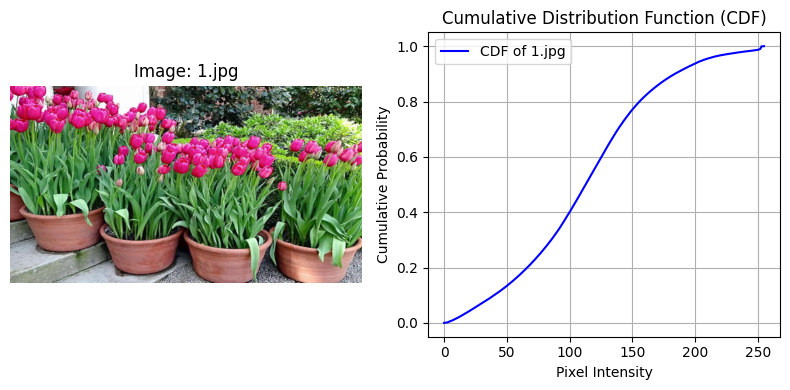

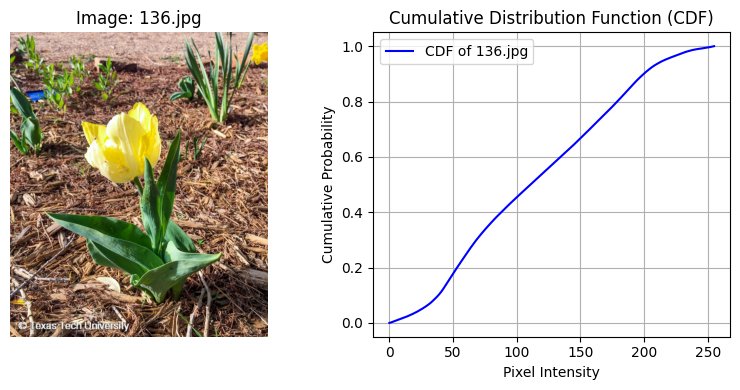

CDF Metrics:
Average 25th Percentile: 0.21036048997334547 (sigma = 0.16933134287873758)
Average 50th Percentile (Median): 0.5435584974107371 (sigma = 0.2248205067604678)
Average 75th Percentile: 0.7902593131115853 (sigma = 0.22724798275497177)
Average Contrast (Dynamic Range): 0.991760292400659 (sigma = 0.06384293345001296)
Average Skewness: 0.08987932579838576 (sigma = 0.8360844452545027)


In [ ]:
avg_p25, avg_p50, avg_p75, avg_contrast, avg_skewness, std_p25, std_p50, std_p75, std_contrast, std_skewness = calculate_average_cdf_metrics(DATA_DIR)

print("CDF Metrics:")
print(f"Average 25th Percentile: {avg_p25} (sigma = {std_p25})")
print(f"Average 50th Percentile (Median): {avg_p50} (sigma = {std_p50})")
print(f"Average 75th Percentile: {avg_p75} (sigma = {std_p75})")
print(f"Average Contrast (Dynamic Range): {avg_contrast} (sigma = {std_contrast})")
print(f"Average Skewness: {avg_skewness} (sigma = {std_skewness})")

On the CDF graphs, we see that the curve is quite steep for images with white backgrounds.

The averages at the 1st, 2nd, and 3rd quantiles indicate that we have differently dark pixels on average, about as many darker as lighter pixels.\
Contrast in this case is the difference between the pixels with the highest and lowest intensity. This value is quite high, almost 1, which means that on average we have the lightest and darkest pixels in the image.\
The skewness of the intensity distribution of the images in the grayscale space is slightly positive, which indicates that it is slightly more in favor of bright pixels. The standard deviation of about 0.84 is quite large, which means that this value varies quite a bit.

## 1.4 Mean & Median

### Function

In [ ]:
def compute_color_statistics(image_path, color_space='rgb'):
    image = cv2.imread(image_path)

    # Convert the image to the specified color space
    if color_space == 'rgb':
        image_converted = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        channels = cv2.split(image_converted)
        channel_names = ['Red', 'Green', 'Blue']
        scaling_factors = [255, 255, 255]
    elif color_space == 'hsv':
        image_converted = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
        channels = cv2.split(image_converted)
        channel_names = ['Hue', 'Saturation', 'Value']
        scaling_factors = [179, 255, 255]
    elif color_space == 'lab':
        image_converted = cv2.cvtColor(image, cv2.COLOR_BGR2Lab)
        channels = cv2.split(image_converted)
        channel_names = ['L', 'a', 'b']
        scaling_factors = [255, 255, 255]
    else:
        raise ValueError("Unsupported color space. Choose 'rgb', 'hsv', or 'lab'.")

    # Calculate statistics for each channel
    stats = {}
    for channel_name, channel, scale in zip(channel_names, channels, scaling_factors):

        stats[channel_name] = {
            'mean': np.mean(channel),
            'median': np.median(channel),
        }

    return stats

def plot_color_statistics(image_dir, color_space='rgb', num_images=10):
    means = {channel: [] for channel in ['Red', 'Green', 'Blue']} if color_space == 'rgb' else (
            {channel: [] for channel in ['Hue', 'Saturation', 'Value']} if color_space == 'hsv' else
            {channel: [] for channel in ['L', 'a', 'b']}
        )
    medians = means.copy()

    image_paths = [os.path.join(image_dir, f) for f in os.listdir(image_dir) if f.lower().endswith(('jpg', 'jpeg', 'png', 'bmp', 'tiff'))][:num_images]

    fig, axs = plt.subplots(len(image_paths), 3, figsize=(12, 3 * len(image_paths)))

    for idx, image_path in enumerate(image_paths):
        image = io.imread(image_path)

        # Get the image statistics for this image
        stats = compute_color_statistics(image_path, color_space=color_space)
        for channel in stats.keys():
            means[channel].append(stats[channel]['mean'])
            medians[channel].append(stats[channel]['median'])

        axs[idx, 0].imshow(image)
        axs[idx, 0].set_title(f"Image {idx + 1}")
        axs[idx, 0].axis('off')

        # Prepare the colors for display in RGB
        def convert_to_rgb(color_values):
            if color_space == 'hsv':
                # Convert HSV to RGB (Scale Hue to 0-1 range, S and V to 0-1)
                color_rgb = color.hsv2rgb(np.array([[[
                    color_values[0] / 180,   # OpenCV Hue range is 0-180
                    color_values[1] / 255,   # Saturation range is 0-255
                    color_values[2] / 255    # Value range is 0-255
                ]]]))
            elif color_space == 'lab':
                # Convert Lab to RGB (scale L to 0-100, a and b to -128 to 127)
                color_rgb = color.lab2rgb(np.array([[[
                    (color_values[0] / 255) * 100,      # Scale L from 0-255 to 0-100
                    color_values[1] - 128,              # Center a around 0 (-128 to 127)
                    color_values[2] - 128               # Center b around 0 (-128 to 127)
                ]]]))
            else:
                # RGB already in range 0-255
                color_rgb = np.array([[color_values]]) / 255.0
            return color_rgb[0, 0]

        # Plot Mean Color
        mean_color = convert_to_rgb([stats[channel]['mean'] for channel in stats.keys()])
        axs[idx, 1].imshow([[mean_color]])
        axs[idx, 1].set_title(f"Mean Color of Image {idx + 1}")
        axs[idx, 1].axis('off')

        # Plot Median Color
        median_color = convert_to_rgb([stats[channel]['median'] for channel in stats.keys()])
        axs[idx, 2].imshow([[median_color]])
        axs[idx, 2].set_title(f"Median Color of Image {idx + 1}")
        axs[idx, 2].axis('off')

    plt.tight_layout()
    plt.show()


### 1.1.2 RGB Analysis

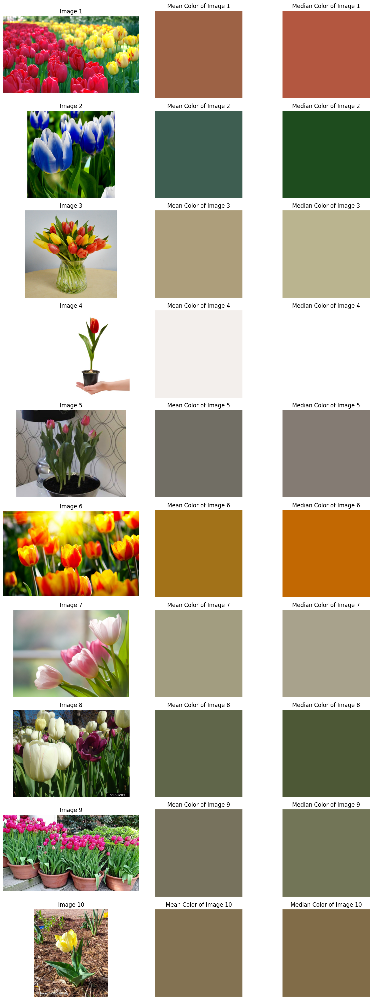

In [ ]:
plot_color_statistics(DATA_DIR, color_space='rgb')

The average and median of the R, G and B values ​​give similar results and appear solid.

### 1.1.3 HSV Analysis

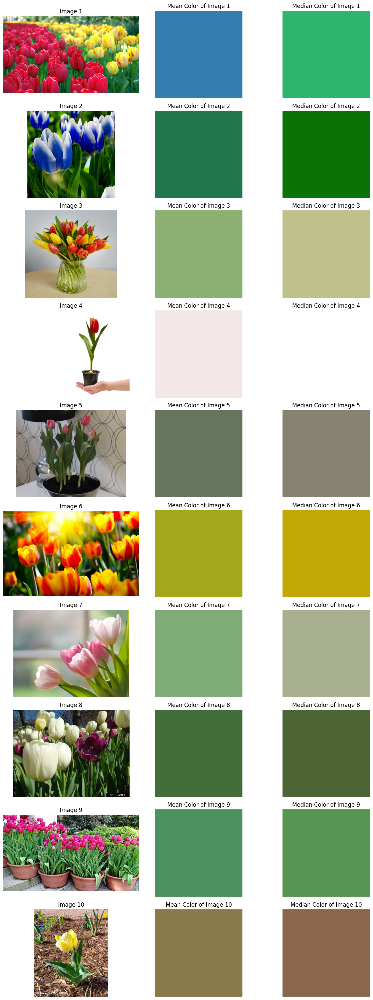

In [ ]:
plot_color_statistics(DATA_DIR, color_space='hsv')

As for the HSV spectrum, median values ​​performed quite well: Mean values ​​describe the most dominant color less well.

### 1.1.4 Lab Analysis

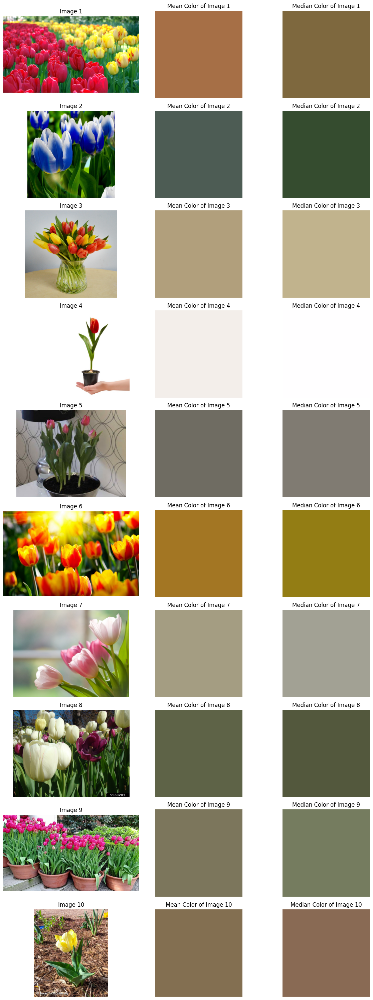

In [ ]:
plot_color_statistics(DATA_DIR, color_space='lab')

Observing the values ​​in the Lab spectrum did not lead to good dominant colors.

## 1.5 KMeans

### Function

In [3]:
def compute_kmeans(image_path, color_space='rgb', num_clusters=5, scale_percent=10):
    if isinstance(image_path, str):
        image = cv2.imread(image_path)
    else:
        image = image_path.permute(1, 2, 0).cpu().numpy()
        # Convert from range [0, 1] to [0, 255] if necessary
        if image.max() <= 1.0:  # Check if it's normalized
            image = (image * 255).astype(np.uint8)
        else:
            image = image.astype(np.uint8)  # Ensure the data type is uint8

    width = int(image.shape[1] * scale_percent / 100)
    height = int(image.shape[0] * scale_percent / 100)

    # dsize
    dsize = (width, height)

    # resize image
    image = cv2.resize(image, dsize)

    # Convert the image to the specified color space
    if color_space == 'rgb':
        image_converted = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    elif color_space == 'hsv':
        image_converted = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
        # Normalize HSV: Hue [0, 179] to [0, 1], Saturation [0, 255] to [0, 1], Value [0, 255] to [0, 1]
        image_converted = image_converted.astype(np.float32)
        image_converted[..., 0] /= 179.0  # Normalize Hue
        image_converted[..., 1] /= 255.0  # Normalize Saturation
        image_converted[..., 2] /= 255.0  # Normalize Value
    elif color_space == 'lab':
        image_converted = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        # Normalize Lab: L [0, 255] to [0, 1], a and b [-128, 127] to [-1, 1]
        image_converted = image_converted.astype(np.float32)
        image_converted[..., 0] /= 255.0  # Normalize L
        image_converted[..., 1] /= 128.0  # Normalize a
        image_converted[..., 2] /= 128.0  # Normalize b
    else:
        raise ValueError("Unsupported color space. Choose 'rgb', 'hsv', or 'lab'.")

    # Reshape the image to be a list of pixels
    pixels = image_converted.reshape((-1, 3))

    # Apply KMeans
    kmeans = KMeans(n_clusters=num_clusters, init='k-means++', random_state=42)
    kmeans.fit(pixels)

    unique, counts = np.unique(kmeans.labels_, return_counts=True)

    idx =  unique[np.argmax(counts)]

    dominant_color = kmeans.cluster_centers_[idx]

    # Convert the dominant color back to RGB for display and scale the values
    if color_space == 'hsv':
       dominant_color = cv2.cvtColor(np.uint8([[dominant_color* [179, 255, 255]]]), cv2.COLOR_HSV2RGB)[0][0]
    elif color_space == 'lab':
        dominant_color = cv2.cvtColor(np.uint8([[dominant_color* [255, 128, 128]]]), cv2.COLOR_LAB2RGB)[0][0]

    dominant_color = dominant_color.astype(np.float32) / 255.
    return dominant_color, kmeans

def plot_kmeans_dominant(image_dir, color_space='rgb', num_clusters=5, n_images=5, scale_percent=10):
    image_paths = [os.path.join(image_dir, f) for f in os.listdir(image_dir) if f.lower().endswith(('jpg', 'jpeg', 'png', 'bmp', 'tiff'))][:n_images]

    fig, axs = plt.subplots(len(image_paths), 3, figsize=(12, 3 * len(image_paths)))

    for idx, image_path in enumerate(image_paths):
        image = io.imread(image_path)

        dominant_color, kmeans = compute_kmeans(image_path, color_space=color_space, num_clusters=num_clusters, scale_percent=scale_percent)

        # Reshape labels to the image shape to visualize clusters
        labels = kmeans.labels_.reshape((image.shape[0]*scale_percent//100, image.shape[1]*scale_percent//100))

        # Highlight the dominant cluster
        dominant_cluster = np.full_like(labels, fill_value=255)  # Set non-dominant areas to white
        dominant_cluster[labels == np.argmax(np.bincount(kmeans.labels_))] = 0  # Label dominant area as black

        axs[idx, 0].imshow(image)
        axs[idx, 0].set_title(f"Image {idx + 1}")
        axs[idx, 0].axis('off')

        # Display the dominant color
        axs[idx, 1].imshow([[dominant_color]])
        axs[idx, 1].set_title("Dominant Color")
        axs[idx, 1].axis('off')

        # Display the cluster map with dominant cluster highlighted
        axs[idx, 2].imshow(dominant_cluster, cmap='gray')
        axs[idx, 2].set_title("Dominant Cluster Highlighted")
        axs[idx, 2].axis('off')

    plt.tight_layout()
    plt.show()

### 1.2.1 RGB

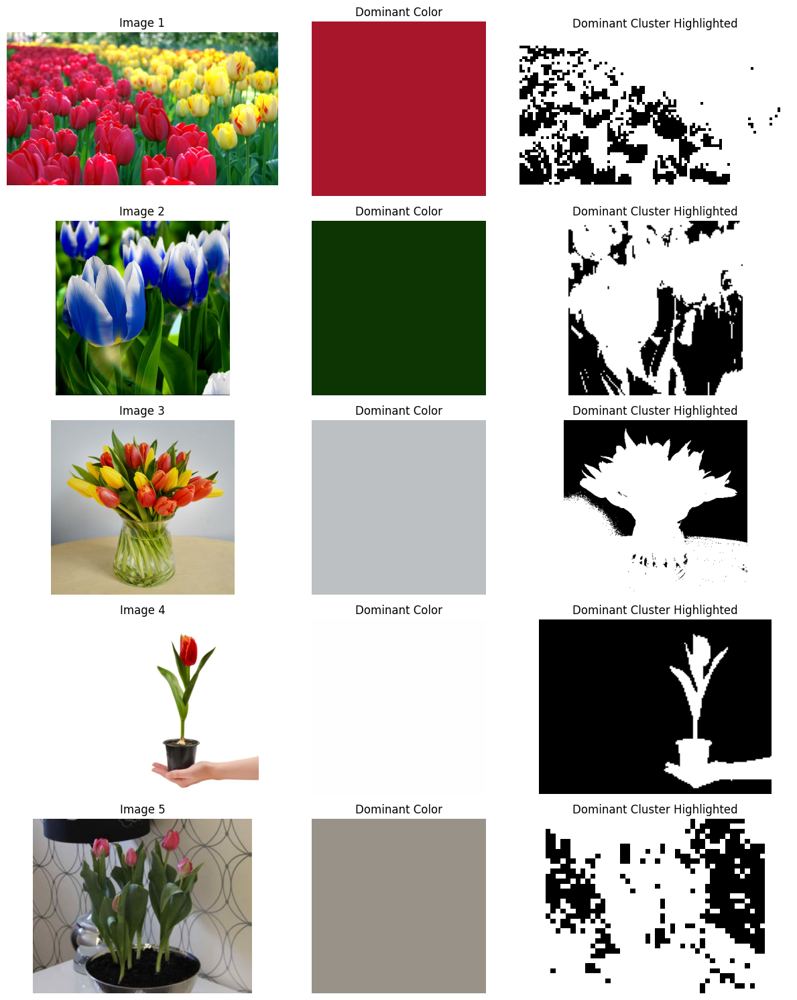

In [ ]:
plot_kmeans_dominant(DATA_DIR, color_space='rgb')

### 1.2.2 HSV

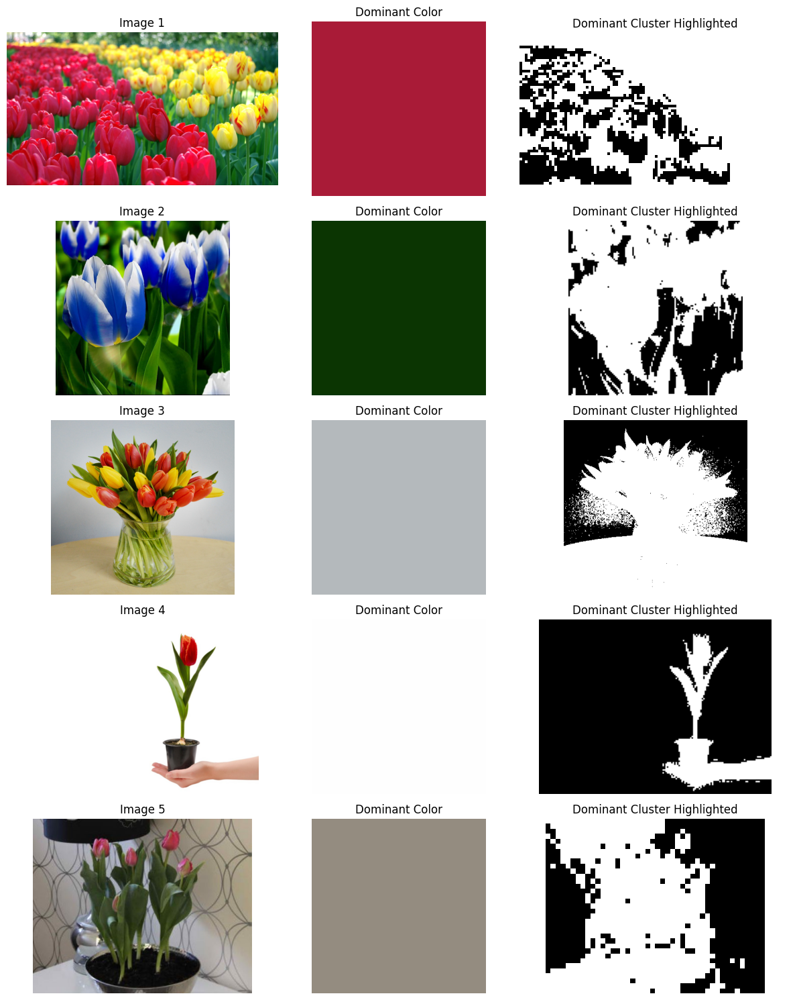

In [ ]:
plot_kmeans_dominant(DATA_DIR, color_space='hsv')

### 1.2.3 Lab

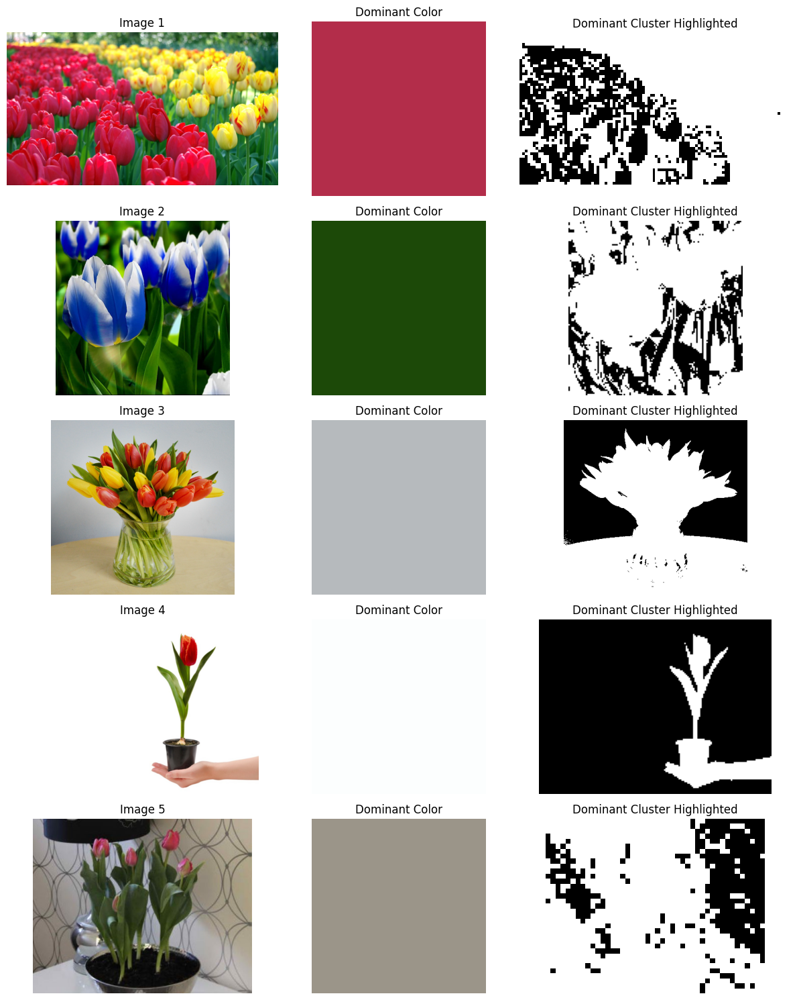

In [ ]:
plot_kmeans_dominant(DATA_DIR, color_space='lab')

The KMeans clustering algorithm with k=5 performed very well in all three spaces, perhaps best in the LAB space. It gives very meaningful results for dominant colors. On images with marked dominant clusters, we can see how much of the image surface is occupied by the selected dominant color. Looking at the spatial position of the colors of the image, and such grouping is intuitively the best way to determine the dominant color.

## 1.6 Max HSV Histogram value

In [ ]:
def get_dominant_color_hsv(image):
    # Convert the image to HSV color space
    hsv_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)

    # Compute the histogram of the HSV image
    h_hist = cv2.calcHist([hsv_image], [0], None, [180], [0, 180])  # Hue histogram
    s_hist = cv2.calcHist([hsv_image], [1], None, [256], [0, 256])  # Saturation histogram
    v_hist = cv2.calcHist([hsv_image], [2], None, [256], [0, 256])  # Value histogram

    # Find the index of the max value in the HSV histogram (dominant color)
    dominant_hue = np.argmax(h_hist)
    dominant_saturation = np.argmax(s_hist)
    dominant_value = np.argmax(v_hist)

    # Convert back to RGB color space
    dominant_color = cv2.cvtColor(np.uint8([[[dominant_hue, dominant_saturation, dominant_value]]]),
                                  cv2.COLOR_HSV2RGB)[0][0]

    return dominant_color/255.

def plot_dominant_color_with_hist(image_dir, n_images=10):
    image_paths = [os.path.join(image_dir, f) for f in os.listdir(image_dir) if f.lower().endswith(('jpg', 'jpeg', 'png', 'bmp', 'tiff'))][:n_images]

    fig, axs = plt.subplots(len(image_paths), 3, figsize=(12, 3 * len(image_paths)))

    for idx, image_path in enumerate(image_paths):
        image = cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)

        dominant_color = get_dominant_color_hsv(image)

        hsv_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
        h_hist = cv2.calcHist([hsv_image], [0], None, [180], [0, 180])

        # Highlight the dominant hue in the histogram
        cluster_visual = np.zeros_like(h_hist)
        cluster_visual[np.argmax(h_hist)] = h_hist.max()

        axs[idx, 0].imshow(image)
        axs[idx, 0].set_title(f"Image {idx + 1}")
        axs[idx, 0].axis('off')

        # Show the dominant color
        axs[idx, 1].imshow([[dominant_color]])
        axs[idx, 1].set_title("Dominant Color")
        axs[idx, 1].axis('off')

        # Display the histogram with the dominant hue highlighted
        axs[idx, 2].plot(h_hist, color='orange', label='Hue Histogram')
        axs[idx, 2].plot(cluster_visual, color='red', label='Dominant Hue')
        axs[idx, 2].set_title("Hue Histogram with Dominant Hue Highlighted")
        axs[idx, 2].legend()
        axs[idx, 2].axis('on')

    plt.tight_layout()
    plt.show()

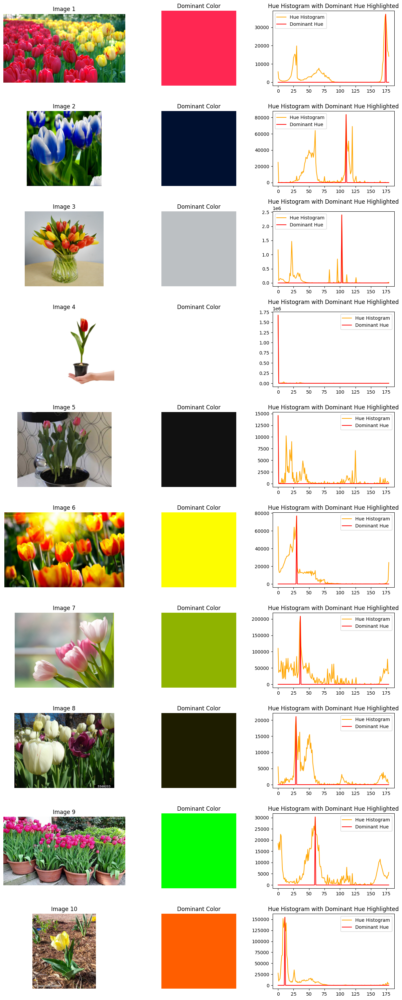

In [ ]:
plot_dominant_color_with_hist(DATA_DIR)

With the HSV histogram method, a couple of problems arise. Taking into account only the maximum values ​​of hue, saturation and value, we get a color that does not necessarily represent the most dominant color in the image. Often a color with a smaller e.g. saturation can dominate.

## 1.7 Generating Dataset

In [4]:
class DominantColorDataset(Dataset):
    def __init__(self, image_dir, label_file='labels.json', transform=None, color_space='lab'):
        self.image_dir = image_dir
        self.image_paths = [os.path.join(image_dir, f) for f in os.listdir(image_dir) if f.lower().endswith(('jpg', 'jpeg', 'png', 'bmp', 'tiff', 'webp', 'jpe'))]
        self.transform = transform
        self.label_file = label_file
        self.color_space = color_space

        if os.path.exists(label_file):
            with open(label_file, 'r') as f:
                self.labels = json.load(f)
        else:
          self.labels = self._compute_and_save_labels()

    def _compute_and_save_labels(self):
        labels = {}
        labels_serializable = {}
        for image_path in tqdm(self.image_paths, desc="Computing labels"):
            image_name = os.path.basename(image_path)
            labels[image_name] = compute_kmeans(image_path, color_space=self.color_space, num_clusters=5)[0]
            labels_serializable[image_name] = labels[image_name].tolist()

        # Save labels to file
        with open(self.label_file, 'w') as f:
            json.dump(labels_serializable, f)

        return labels

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        image = cv2.imread(image_path)
        image_name = os.path.basename(image_path)

        # Apply transformation if any
        if self.transform:
            image = self.transform(image)

        label = torch.tensor(self.labels[image_name], dtype=torch.float32)
        return image, label

In [5]:
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((224, 224)),
    transforms.ToTensor()
])

dataset = DominantColorDataset(image_dir=DATA_DIR, label_file='labels.json', transform=transform)
dataloader = DataLoader(dataset, batch_size=32, shuffle=True)

for images, labels in dataloader:
    print("Image batch shape:", images.shape)
    print("Label batch shape:", labels.shape)
    break

Image batch shape: torch.Size([32, 3, 224, 224])
Label batch shape: torch.Size([32, 3])


### 1.7.1 Testing the dataset

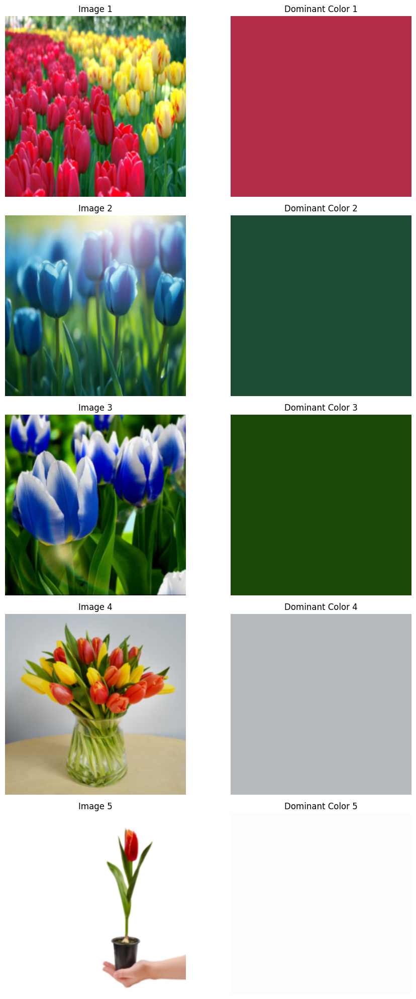

In [6]:
import matplotlib.pyplot as plt
import numpy as np

def plot_images_with_dominant_colors(dataset, num_images=3):
    fig, axes = plt.subplots(num_images, 2, figsize=(10, num_images * 4))

    for i in range(num_images):
        # Get image and label
        image, dominant_color = dataset[i]
        image = image.permute(1, 2, 0).numpy()

        # Convert BGR image to RGB for displaying
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Plot the original image
        axes[i, 0].imshow(image_rgb)
        axes[i, 0].axis('off')
        axes[i, 0].set_title(f"Image {i+1}")

        # Create a patch with the dominant color
        dominant_color_patch = np.zeros((100, 100, 3), dtype=np.uint8)
        dominant_color_patch[:] = (dominant_color.numpy() * 255).astype(np.uint8)  # Scale from [0,1] to [0,255]

        # Plot the dominant color
        axes[i, 1].imshow(dominant_color_patch)
        axes[i, 1].axis('off')
        axes[i, 1].set_title(f"Dominant Color {i+1}")

    plt.tight_layout()
    plt.show()

# Example usage
plot_images_with_dominant_colors(dataset, num_images=5)


## 1.8 3D Color Graph

In [ ]:
dominant_colors = []

# Iterate through the dataset and collect dominant colors
for images, colors in dataloader:
    dominant_colors.extend(colors.numpy())

In [ ]:
def plot_dominant_colors_3d(dominant_colors):
    # Convert the dominant colors array to a DataFrame
    df = pd.DataFrame(dominant_colors, columns=['Red', 'Green', 'Blue'])

    # Create a color column using the actual RGB values
    # Note: Plotly expects colors in the range [0,255] for rgb values
    df['Color'] = df.apply(
        lambda row: f'rgb({int(row.Red*255)},{int(row.Green*255)},{int(row.Blue*255)})',
        axis=1
    )

    # Create a 3D scatter plot with custom marker colors
    fig = px.scatter_3d(
        df,
        x='Red',
        y='Green',
        z='Blue',
        title='Dominant Color Distribution in RGB Space',
        labels={'Red': 'Red', 'Green': 'Green', 'Blue': 'Blue'}
    )

    # Update traces to use the actual RGB colors for markers
    fig.update_traces(
        marker=dict(
            color=df['Color'],
            size=8,
            opacity=0.8
        ),
        hovertemplate=(
            'Red: %{x:.3f}<br>' +
            'Green: %{y:.3f}<br>' +
            'Blue: %{z:.3f}<br>'
        )
    )

    # Update layout for better visualization
    fig.update_layout(
        scene=dict(
            xaxis=dict(range=[0, 1]),
            yaxis=dict(range=[0, 1]),
            zaxis=dict(range=[0, 1])
        )
    )

    # Show the plot
    fig.show()


In [ ]:
plot_dominant_colors_3d(dominant_colors)

Kako lale mogu biti raznih boja, dijagram sadrži plave, roze, ljubičaste, žute, crvene i ostale boje. Zelena boja dolazi iz stabljike ili biljki u pozadini. Bela, a često i crna boja su dominantne u pozadini. Braon i varijacije crvene i narandžaste dolaze iz zemljišta.

## 1.9 2D Color Graph

In [ ]:
def plot_dominant_colors_2d(dominant_colors, x_channel_idx=0, y_channel_idx=1):
    x_vals = [color[x_channel_idx] for color in dominant_colors]
    y_vals = [color[y_channel_idx] for color in dominant_colors]

    plt.figure(figsize=(6, 4))
    plt.scatter(x_vals, y_vals, c=dominant_colors, marker='o', s=50, edgecolors='black', linewidth=1)

    idx_to_name = {0: 'Red', 1: 'Green', 2: 'Blue'}

    plt.title(f'Dominant Color Distribution in {idx_to_name[x_channel_idx]}-{idx_to_name[y_channel_idx]} Space')
    plt.xlabel(idx_to_name[x_channel_idx])
    plt.ylabel(idx_to_name[y_channel_idx])
    plt.show()

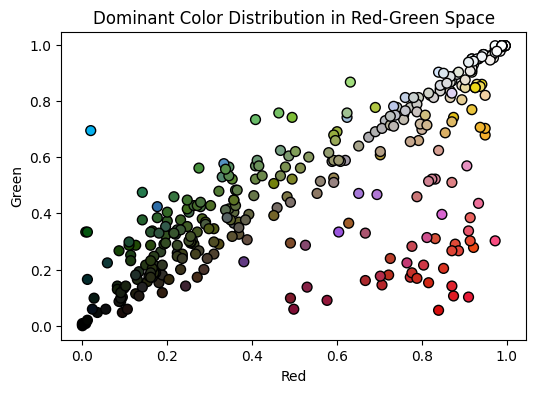

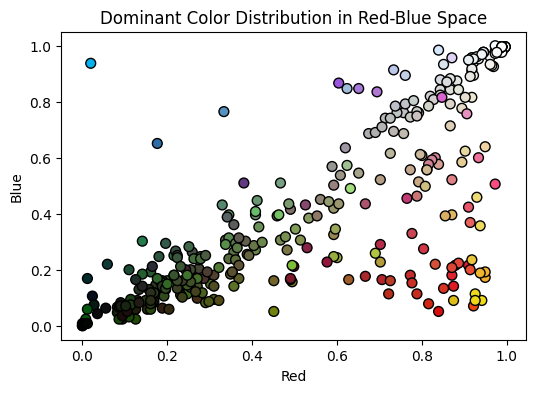

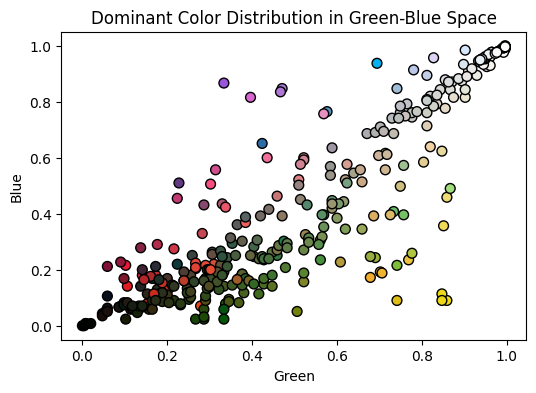

In [ ]:
plot_dominant_colors_2d(dominant_colors)
plot_dominant_colors_2d(dominant_colors, 0, 2)
plot_dominant_colors_2d(dominant_colors, 1, 2)

Primećuje se da se najviše dominantnih boja nalazi na dijagonalama grafova. Ovo znači da se vrlo često boje pozadine biraju kao dominantne.

# 2. CNN Building and Training

## 2.1 Creating Train, Val and Test Datasets

### 2.1.1 Splitting the data

In [7]:
import torch
from torch.utils.data import DataLoader, random_split

# 70% train, 15% val, 15% test
total_size = len(dataset)
test_size = int(0.15 * total_size)
val_size = int(0.15 * total_size)
train_size = total_size - val_size - test_size

# Split the dataset
train_dataset, val_dataset, test_dataset = random_split(dataset,
 [train_size, val_size, test_size],
 generator=torch.Generator().manual_seed(42))

print(f'Train size: {train_size}, Val Size: {val_size}, Test Size: {test_size}')

Train size: 239, Val Size: 51, Test Size: 51


### 2.1.2 Data Augmentation

In [8]:
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import numpy as np

class AugmentedDataset(Dataset):
    def __init__(self, original_dataset, transform=None, augmentation_factor=2, random_seed=42, color_space='lab'):
        self.dataset = original_dataset
        self.transform = transform
        self.random_seed = random_seed
        self.augmentation_factor = augmentation_factor
        self.color_space = color_space

    def __len__(self):
        return len(self.dataset) * self.augmentation_factor

    def __getitem__(self, idx):
        original_idx = idx // self.augmentation_factor
        image, label = self.dataset[original_idx]

        random.seed(self.random_seed + original_idx)
        torch.manual_seed(self.random_seed + original_idx)
        random.seed(self.random_seed + original_idx)

        is_augmented = (idx % self.augmentation_factor) != 0
        if self.transform and is_augmented:
            image = self.transform(image)
            augmented_label = compute_kmeans(image, color_space=self.color_space, num_clusters=5)[0]
            label = torch.clamp(torch.tensor(augmented_label, dtype=torch.float32), 0, 1)

        return image, label

# Example usage
def create_augmented_dataloader(original_dataset, train_transforms, augmentation_factor=2, batch_size=32, shuffle=True):
    augmented_dataset = AugmentedDataset(
        original_dataset=original_dataset,
        transform=train_transforms,
        augmentation_factor=augmentation_factor
    )

    return DataLoader(
        augmented_dataset,
        batch_size=batch_size,
        shuffle=shuffle
    )

In [9]:
def add_gaussian_noise(image, mean=0.0, std=1.0):
    noise = torch.randn_like(image) * std + mean
    return image + noise


# Augmentation pipeline
augmentation_pipeline = transforms.Compose([
    transforms.RandomHorizontalFlip(p=0.4),
    transforms.RandomVerticalFlip(p=0.4),
    transforms.GaussianBlur(kernel_size=(1, 5), sigma=(0.1, 2.5)),
    transforms.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.1),
    transforms.RandomRotation(degrees=20),
    transforms.RandomResizedCrop(size=(224, 224), scale=(0.6, 0.6)),
    v2.GaussianNoise(sigma=0.05)
])


### 2.1.3 Creating DataLoader Objects

In [10]:
# Create DataLoaders
batch_size = 32

train_loader = create_augmented_dataloader(train_dataset, augmentation_pipeline, augmentation_factor=2, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

print(f"Dataset batches - Train: {len(train_loader)}, Val: {len(val_loader)}, Test: {len(test_loader)}")

Dataset batches - Train: 15, Val: 2, Test: 2


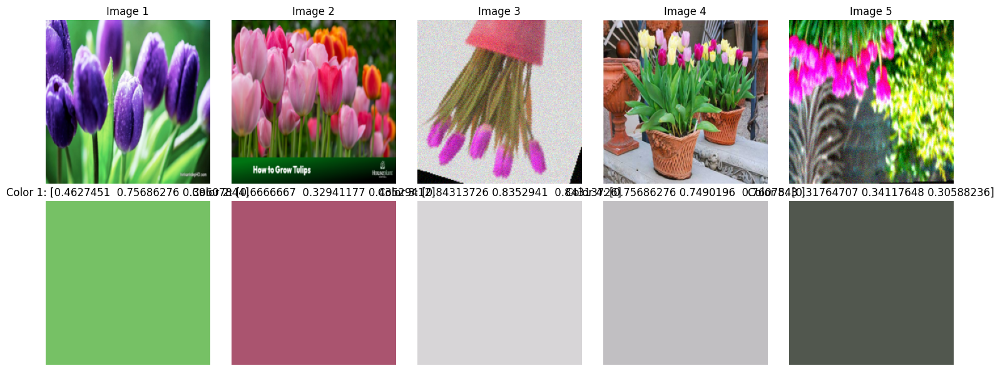

In [11]:
# Get a batch of images
images, labels = next(iter(train_loader))  # Get a batch of test images
images, labels = images.to(device), labels.to(device)

# Plot the first 5 images along with the corresponding labels
plt.figure(figsize=(15, 6))
for i in range(5):
    plt.subplot(2, 5, i + 1)

    # Convert tensor to PIL image and ensure it's in RGB format
    img = images[i].cpu().permute(1, 2, 0).numpy() # Change from CxHxW to HxWxC
    img = img[..., ::-1]


    plt.imshow(img)
    plt.axis('off')
    plt.title(f'Image {i+1}')

    # Plot the corresponding label as color
    plt.subplot(2, 5, 5 + i + 1)
    label_color = labels[i].cpu().numpy()  # Assuming labels are in the form of RGB values (for example)
    plt.imshow([[label_color]])  # Display color as an image
    plt.axis('off')
    plt.title(f'Color {i+1}: {label_color}')

plt.tight_layout()
plt.show()

## 2.2 Basic CNN

### Building

In [12]:
class BasicCNN(nn.Module):
    def __init__(self, input_size=(3, 224, 224)):

        super(BasicCNN, self).__init__()
        # Convolutional layers
        self.conv1 = nn.Conv2d(3, 32, kernel_size=5)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3)

        self.max_pool = nn.MaxPool2d(2, 2)

        # Fully connected layers
        self.fc1 = nn.Linear(64 * 54 * 54, 128)
        self.fc2 = nn.Linear(128, 3)  # Output RGB values

    def forward(self, x):
        x = self.max_pool(nn.functional.relu(self.conv1(x)))
        x = self.max_pool(nn.functional.relu(self.conv2(x)))

        x = x.view(x.size(0), -1)
        x = nn.functional.relu(self.fc1(x))
        x = self.fc2(x)

        return x

    def compute_loss(self, output, target):
        # Compute Mean Absolute Error
        mae_loss = nn.L1Loss()(output, target)

        # Compute Mean Squared Error
        mse_loss = nn.MSELoss()(output, target)

        return mae_loss, mse_loss


    def ttrain(self, train_loader, epoch,  metrics_dict, optimizer, log_interval=1):
      self.train()
      print(f'Train Epoch: {epoch}:')
      batch_losses = []
      batch_mses = []

      # Loop over each batch from the training set
      for batch_idx, (data, target) in enumerate(train_loader):
          # Copy data to GPU if needed
          data = data.to(device)
          target = target.to(device)

          # Zero gradient buffers
          optimizer.zero_grad()

          # Pass data through the network
          output = self(data)

          # Calculate loss
          loss, mse = self.compute_loss(output, target)

          batch_losses.append(loss.data.item())
          batch_mses.append(mse.data.item())

          # Backpropagate
          loss.backward()

          # Update weights
          optimizer.step()

          if batch_idx % log_interval == 0:
              print(f'\tBatch: {batch_idx + 1}: [{batch_idx * len(data)}/{len(train_loader.dataset)} ({100. * batch_idx / len(train_loader):.0f}%)]\tLoss: {loss.data.item():.6f}')

      metrics_dict['train']['MAE']['vals'].append(np.mean(batch_losses))
      metrics_dict['train']['MAE']['stds'].append(np.std(batch_losses))
      metrics_dict['train']["MSE"]['vals'].append(np.mean(batch_mses))
      metrics_dict['train']['MSE']['stds'].append(np.std(batch_mses))

    def vval(self, val_loader, metrics_dict):
        self.eval()
        val_total_mae, val_total_mse = 0, 0

        with torch.no_grad():
            for data, target in val_loader:
                data, target = data.to(device), target.to(device)

                output = self(data)

                # Calculate losses
                mae, mse = self.compute_loss(output, target)
                val_total_mae += mae.data.item()
                val_total_mse += mse.data.item()

        val_avg_mae = val_total_mae / len(val_loader)
        val_avg_mse = val_total_mse / len(val_loader)

        metrics_dict['val']['MAE'].append(val_avg_mae)
        metrics_dict['val']['MSE'].append(val_avg_mse)


        print(f'\nValidation Results - MAE: {val_avg_mae}, MSE: {val_avg_mse}\n')

### Training

In [13]:
# Set random seed for reproducibility
torch.manual_seed(42)
random.seed(42)
np.random.seed(42)

In [14]:
def train_model(model, epochs, optimizer, early_stopping_patience=5, model_save_fname=None, history_save_fpath=None):
    metrics_dict = {
      'train':{
          'MAE': {
              'stds': [0],
              'vals':[0]
          },
          'MSE': {
              'stds': [0],
              'vals':[0]
          }
      },
      'val':{
          'MAE': [],
          'MSE': [],
      }

    }

    model.vval(val_loader, metrics_dict)

    best_loss = metrics_dict['val']['MAE'][-1]
    epochs_without_improvement = 0

    for epoch in range(1, epochs + 1):
        model.ttrain(train_loader, epoch, metrics_dict, optimizer)
        model.vval(val_loader, metrics_dict)

        current_loss = metrics_dict['val']['MAE'][-1]

        if current_loss < best_loss:
            print("New best loss reached!\n")
            best_loss = current_loss
            epochs_without_improvement = 0
            if model_save_fname:
                best_model_state_dict = model.state_dict()
                torch.save(best_model_state_dict, model_save_fname)
        else:
            epochs_without_improvement += 1

        if epochs_without_improvement >= early_stopping_patience:
            print(f"Early stopping at epoch {epoch}. No improvement in validation MAE for {early_stopping_patience} consecutive epochs.")
            break

    if history_save_fpath:
        with open(history_save_fpath, 'wb') as f:
            pickle.dump(metrics_dict, f)


    return metrics_dict

In [ ]:
model_1 = BasicCNN().to(device)
optimizer = torch.optim.Adam(model_1.parameters(), lr=0.001)

history_1 = train_model(model_1, 20, optimizer, 5, 'model1', 'history1.pkl')


Validation Results - MAE: 0.5154798924922943, MSE: 0.35528144240379333

Train Epoch: 1:
	Batch: 1: [0/478 (0%)]	Loss: 0.392965
	Batch: 2: [32/478 (7%)]	Loss: 10.022224
	Batch: 3: [64/478 (13%)]	Loss: 3.717484
	Batch: 4: [96/478 (20%)]	Loss: 1.271599
	Batch: 5: [128/478 (27%)]	Loss: 0.547602
	Batch: 6: [160/478 (33%)]	Loss: 0.556722
	Batch: 7: [192/478 (40%)]	Loss: 0.568754
	Batch: 8: [224/478 (47%)]	Loss: 0.434397
	Batch: 9: [256/478 (53%)]	Loss: 0.426183
	Batch: 10: [288/478 (60%)]	Loss: 0.401394
	Batch: 11: [320/478 (67%)]	Loss: 0.333390
	Batch: 12: [352/478 (73%)]	Loss: 0.329601
	Batch: 13: [384/478 (80%)]	Loss: 0.273121
	Batch: 14: [416/478 (87%)]	Loss: 0.234202
	Batch: 15: [420/478 (93%)]	Loss: 0.242742

Validation Results - MAE: 0.23030081391334534, MSE: 0.07868613675236702

New best loss reached!

Train Epoch: 2:
	Batch: 1: [0/478 (0%)]	Loss: 0.221802
	Batch: 2: [32/478 (7%)]	Loss: 0.204074
	Batch: 3: [64/478 (13%)]	Loss: 0.190526
	Batch: 4: [96/478 (20%)]	Loss: 0.202744
	Batch

In [ ]:
model_1 = BasicCNN().to(device)
model_1.load_state_dict(torch.load('model1', weights_only=True, map_location=device))

<All keys matched successfully>

### Plot results

In [15]:
def plot_metrics_history(history_fpath):
    with open(history_fpath, 'rb') as f:
        history = pickle.load(f)

    for k, v in history.items():
      for metric, values in v.items():
        if len(values)==0:
            break
        if isinstance(values, dict):
            plt.errorbar(range(0, len(values['stds'])), values['vals'], yerr=[values['stds'], values['stds']], fmt='o',
                elinewidth=20, ecolor='red',alpha=0.5, color='green')
            values = values['vals']

        if k=='val' and metric=='MAE':
            min_val = min(values)
            min_idx = values.index(min_val)
            plt.scatter(min_idx, min_val, color='red', s=100, zorder=5, label=f'Min {metric}: {min_val:.4f}')
            plt.legend()

        plt.plot(values)
        plt.yscale('linear')
        plt.ylim(bottom=0)
        plt.xticks(range(0, len(values)))
        plt.xlim(0, len(values))
        plt.xlabel('Epoch')
        plt.ylabel('Value')
        plt.title(f'{k} {metric} over time')
        plt.show()

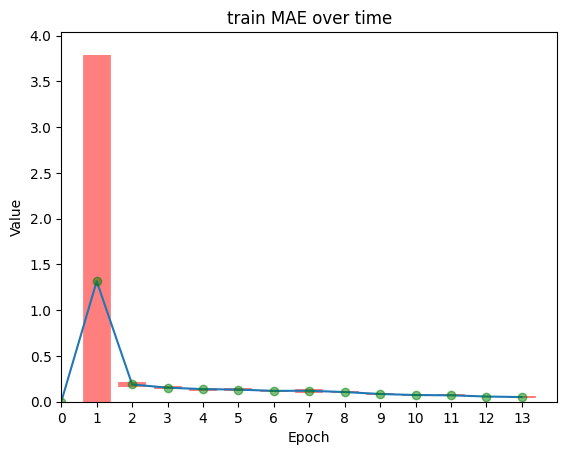

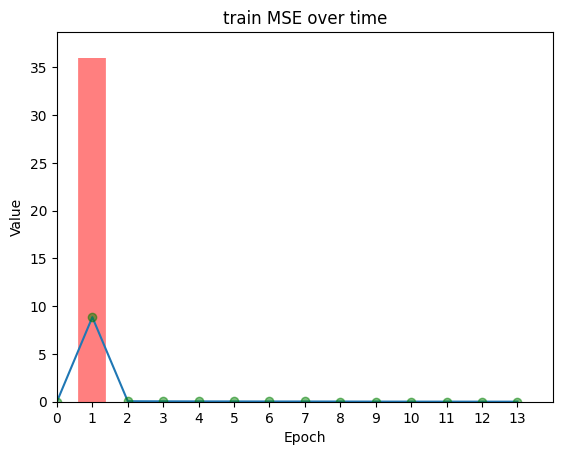

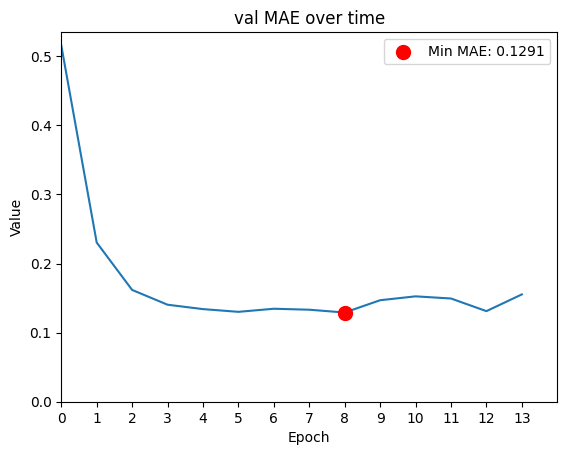

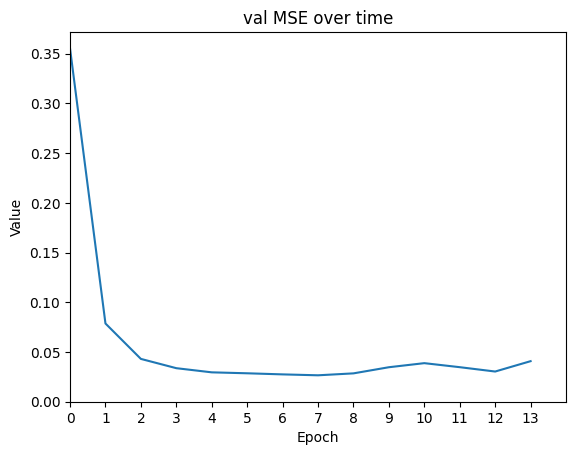

In [ ]:
plot_metrics_history('history1.pkl')

In [16]:
def test_model(model, test_loader):
    model.eval()  # Set model to evaluation mode
    total_mae = 0.0
    total_mse = 0.0
    with torch.no_grad():
        for data, target in test_loader:
            data, target = data.to(device), target.to(device)
            output = model(data)
            mae = nn.L1Loss()(output, target)
            mse = nn.MSELoss()(output, target)
            total_mae += mae.item()
            total_mse += mse.item()

    avg_mae = total_mae / len(test_loader)
    avg_mse = total_mse / len(test_loader)
    print(f"\nTest MAE: {avg_mae:.4f}")
    print(f"Test MSE: {avg_mse:.4f}")

In [54]:
def plot_images_with_predictions(model, test_loader, n_rows=5, imgs_per_row=3):
    model.eval()  # Set model to evaluation mode

    total_images_plotted = 0
    max_images = n_rows * imgs_per_row  # Total number of images to display
    fig, axs = plt.subplots(n_rows, imgs_per_row * 3, figsize=(12, 3 * n_rows))
    axs = axs.reshape(n_rows, imgs_per_row * 3)  # Ensure 2D array for indexing

    for images, labels in test_loader:
        if total_images_plotted >= max_images:
            break  # Stop if we have plotted enough images

        images, labels = images.to(device), labels.to(device)

        # Get model predictions (RGB values)
        with torch.no_grad():
            outputs = model(images)

        batch_size = images.size(0)
        for i in range(batch_size):
            if total_images_plotted >= max_images:
                break  # Stop if we have plotted enough images

            row_idx = total_images_plotted // imgs_per_row
            col_offset = (total_images_plotted % imgs_per_row) * 3

            # Process image, predicted color, and true color
            img_rgb = images[i].cpu().permute(1, 2, 0).numpy()
            img_rgb = img_rgb[..., ::-1]  # Convert from BGR to RGB

            predicted_rgb = outputs[i].cpu().numpy().clip(0, 1)
            true_rgb = labels[i].cpu().numpy().clip(0, 1)

            # Plot the image
            axs[row_idx, col_offset].imshow(img_rgb)
            axs[row_idx, col_offset].set_title(f"Image {total_images_plotted + 1}")
            axs[row_idx, col_offset].axis('off')

            # Plot the predicted color
            axs[row_idx, col_offset + 1].imshow([[predicted_rgb]])
            axs[row_idx, col_offset + 1].set_title(f"Predicted")
            axs[row_idx, col_offset + 1].axis('off')

            # Plot the true color
            axs[row_idx, col_offset + 2].imshow([[true_rgb]])
            axs[row_idx, col_offset + 2].set_title(f"True")
            axs[row_idx, col_offset + 2].axis('off')

            total_images_plotted += 1

    # Hide any remaining unused subplots
    for idx in range(total_images_plotted, n_rows * imgs_per_row):
        row_idx = idx // imgs_per_row
        col_offset = (idx % imgs_per_row) * 3
        axs[row_idx, col_offset].axis('off')
        axs[row_idx, col_offset + 1].axis('off')
        axs[row_idx, col_offset + 2].axis('off')

    plt.tight_layout()
    plt.show()



Test MAE: 0.1284
Test MSE: 0.0291


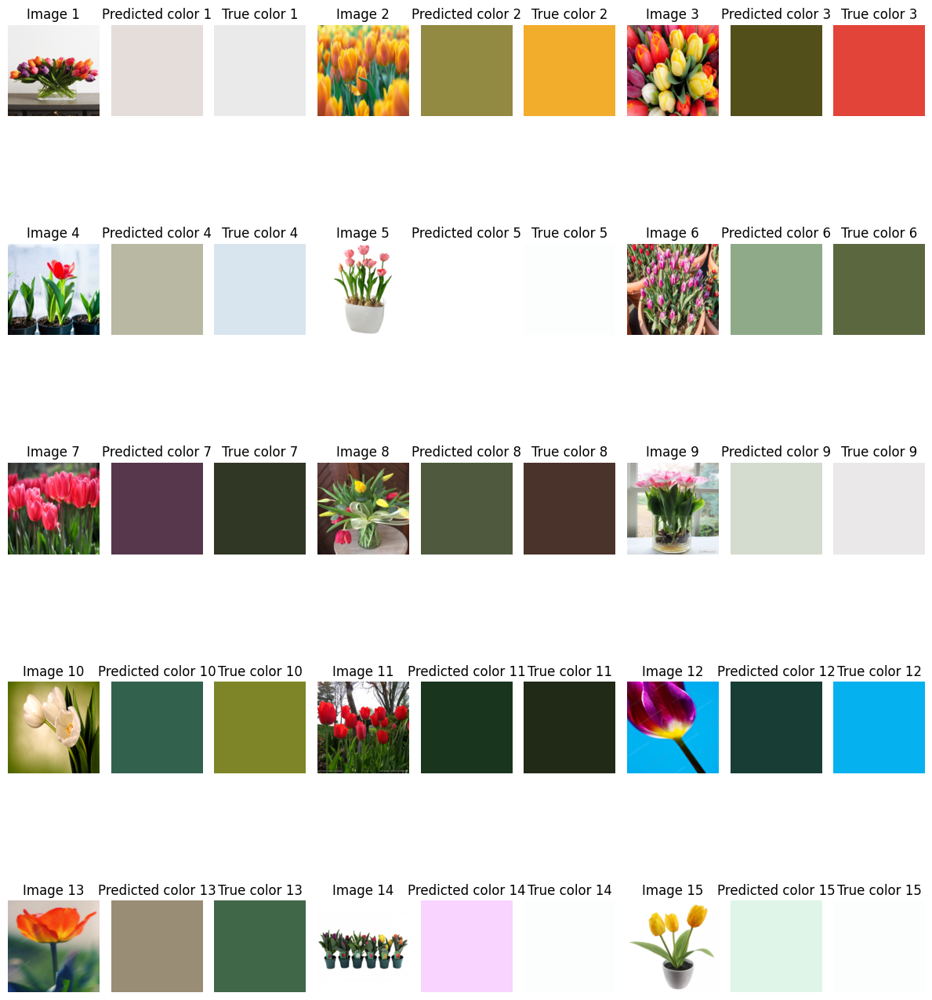

In [ ]:
plot_images_with_predictions(model_1, test_loader)

## 2.3 ResNet

### Building

In [ ]:
class ResNet(BasicCNN):
    def __init__(self, freeze_up_to="layer2"):
        super(ResNet, self).__init__()
        # Load ResNet
        self.resnet = models.resnet18(weights="DEFAULT")

        freeze = True
        for name, param in self.resnet.named_parameters():
            if freeze:
                param.requires_grad = False
            if freeze_up_to in name:  # Stop freezing after the specified layer
                freeze = False


        num_features = self.resnet.fc.in_features
        self.resnet.fc = nn.Identity()
        self.fc = nn.Linear(num_features, 3)

    def forward(self, x):
        x = self.resnet(x)

        x = self.fc(x)

        return torch.sigmoid(x)


### Training

In [ ]:
model_3 = ResNet().to(device)
optimizer = torch.optim.Adam(model_3.parameters(), lr=0.001)


history_3 = train_model(model_3, 30, optimizer, 5, 'model3', 'history3.pkl')


Validation Results - MAE: 0.3133144676685333, MSE: 0.1403208002448082

Train Epoch: 1:
	Batch: 1: [0/478 (0%)]	Loss: 0.308882
	Batch: 2: [32/478 (7%)]	Loss: 0.226671
	Batch: 3: [64/478 (13%)]	Loss: 0.191801
	Batch: 4: [96/478 (20%)]	Loss: 0.231673
	Batch: 5: [128/478 (27%)]	Loss: 0.221332
	Batch: 6: [160/478 (33%)]	Loss: 0.247495
	Batch: 7: [192/478 (40%)]	Loss: 0.217681
	Batch: 8: [224/478 (47%)]	Loss: 0.284836
	Batch: 9: [256/478 (53%)]	Loss: 0.168086
	Batch: 10: [288/478 (60%)]	Loss: 0.274641
	Batch: 11: [320/478 (67%)]	Loss: 0.242987
	Batch: 12: [352/478 (73%)]	Loss: 0.233414
	Batch: 13: [384/478 (80%)]	Loss: 0.157376
	Batch: 14: [416/478 (87%)]	Loss: 0.191095
	Batch: 15: [420/478 (93%)]	Loss: 0.196631

Validation Results - MAE: 0.29220011830329895, MSE: 0.14919690787792206

New best loss reached!

Train Epoch: 2:
	Batch: 1: [0/478 (0%)]	Loss: 0.151206
	Batch: 2: [32/478 (7%)]	Loss: 0.164894
	Batch: 3: [64/478 (13%)]	Loss: 0.171100
	Batch: 4: [96/478 (20%)]	Loss: 0.173294
	Batch: 

In [ ]:
model_3 = ResNet().to(device)
model_3.load_state_dict(torch.load('model3', weights_only=True, map_location=device))

<All keys matched successfully>

### Plot results

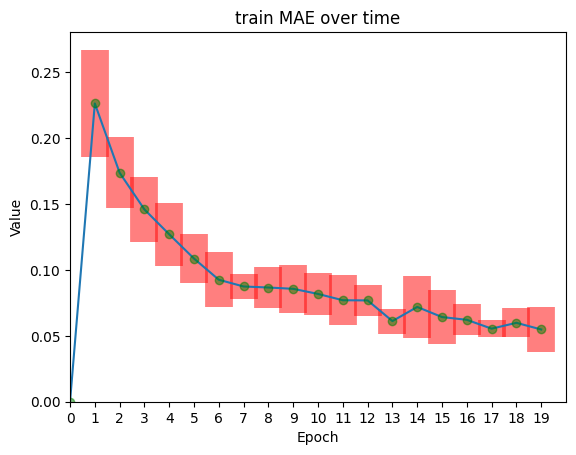

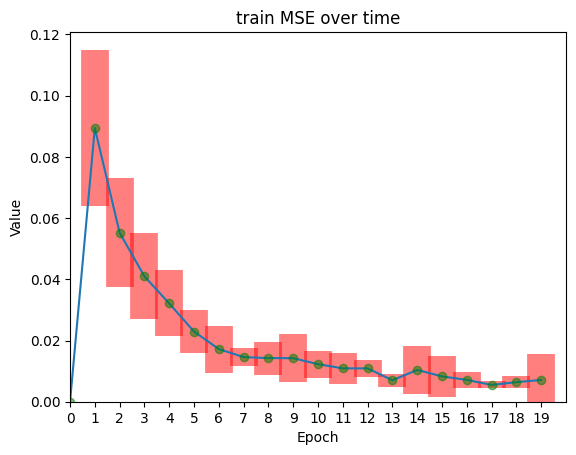

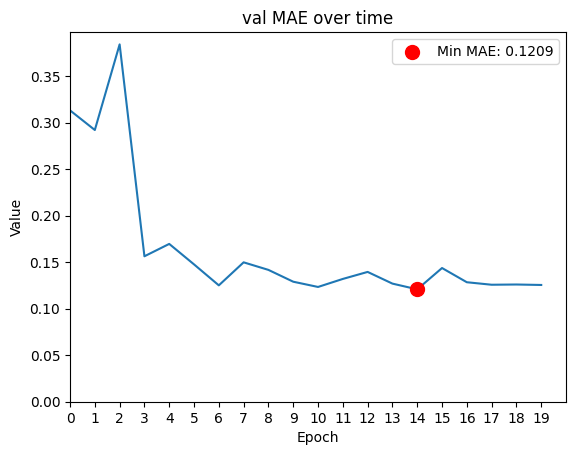

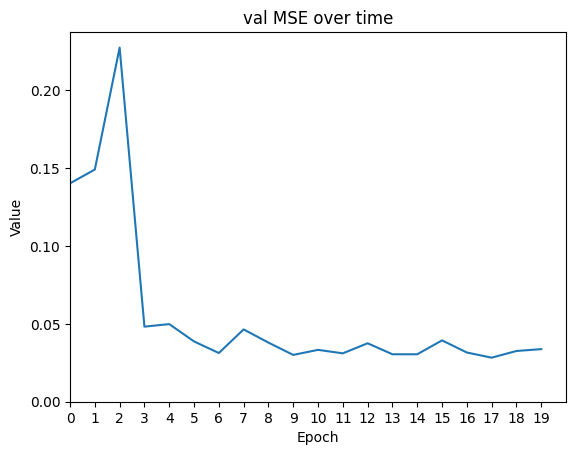

In [ ]:
plot_metrics_history('history3.pkl')


Test MAE: 0.1233
Test MSE: 0.0293


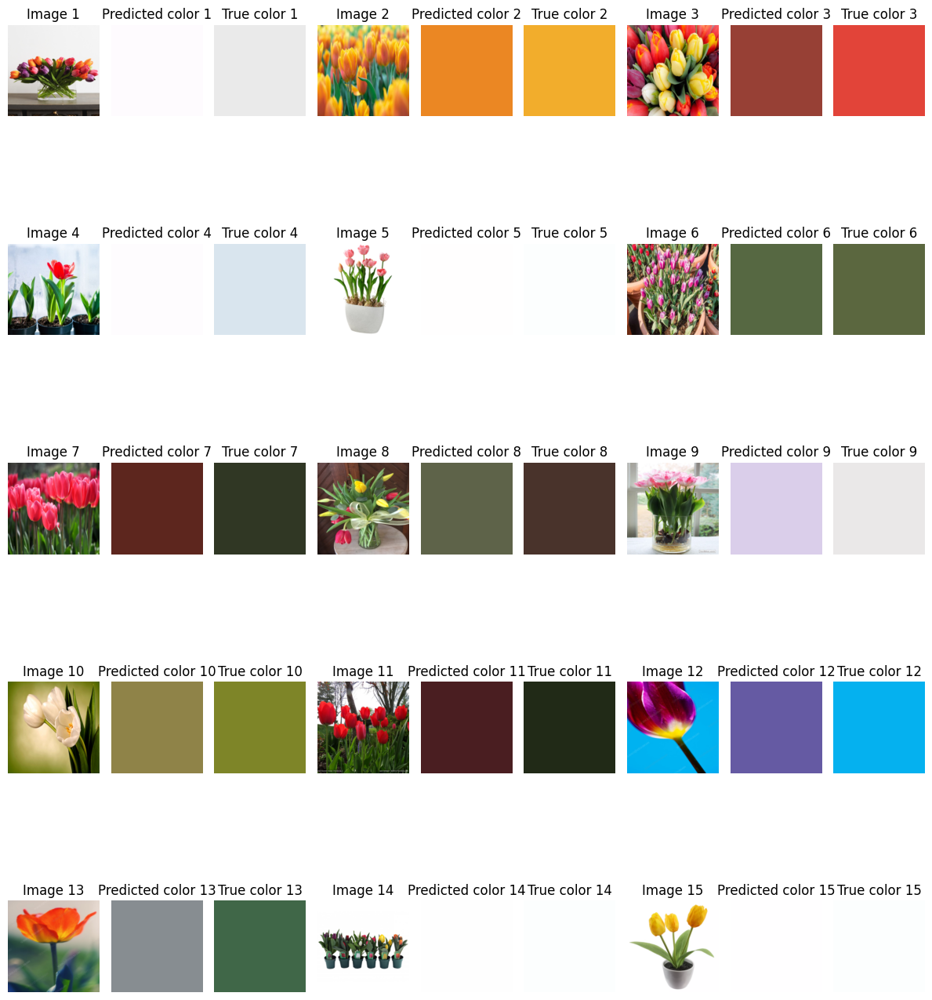

In [ ]:
plot_images_with_predictions(model_3, test_loader)

## 2.4 Advanced CNN Model

### 2.4.1 Modified ResNet V1

#### Building

In [20]:
class SqueezeAndExcitation(nn.Module):
    def __init__(self, in_channels, reduction_ratio=16):
        super(SqueezeAndExcitation, self).__init__()
        self.squeeze = nn.AdaptiveAvgPool2d(1)  # Global pooling to get channel-wise stats
        self.excitation = nn.Sequential(
            nn.Linear(in_channels, in_channels // reduction_ratio),
            nn.ReLU(),
            nn.Linear(in_channels // reduction_ratio, in_channels),
            nn.Sigmoid()
        )

    def forward(self, x):
        batch, channels, _, _ = x.size()
        # Squeeze: Global spatial average pooling
        squeezed = self.squeeze(x).view(batch, channels)
        # Excitation: Fully connected layers
        excited = self.excitation(squeezed).view(batch, channels, 1, 1)
        # Recalibrate: Scale input features by channel importance
        return x * excited


In [ ]:
class ModifiedResNet1(BasicCNN):
    def __init__(self, freeze_up_to="layer2"):
        super(ModifiedResNet1, self).__init__()
        # Load ResNet
        self.base = models.resnet18(weights='DEFAULT')
        self.base.avgpool = nn.Identity()
        self.base.fc = nn.Identity()

        # Add Squeeze-and-Excitation layers
        self.se = SqueezeAndExcitation(in_channels=512)

        self.pool = nn.AdaptiveAvgPool2d((1, 1))

        # Fully connected layers
        self.fc = nn.Sequential(
            nn.Linear(512, 3)
        )

        # Freeze layers up to the specified layer
        freeze = True
        for name, param in self.base.named_parameters():
            if freeze:
                param.requires_grad = False
            if freeze_up_to in name:
                freeze = False

    def forward(self, x):
        # Pass through ResNet base
        x = self.base.conv1(x)
        x = self.base.bn1(x)
        x = self.base.relu(x)
        x = self.base.maxpool(x)

        x = self.base.layer1(x)
        x = self.base.layer2(x)
        x = self.base.layer3(x)
        x = self.base.layer4(x)

        # Apply squeeze-and-excitation
        x = self.se(x)

        x = self.pool(x)

        # Global average pooling
        x = torch.flatten(x, 1)

        # Fully connected layers
        x = self.fc(x)

        return torch.sigmoid(x)


#### Training

In [ ]:
model_5v1 = ModifiedResNet1().to(device)
optimizer = torch.optim.Adam(model_5v1.parameters(), lr=0.001)

history_5v1 = train_model(model_5v1, 30, optimizer, 7, 'model5v1', 'history5v1.pkl')


Validation Results - MAE: 0.27083635330200195, MSE: 0.10185633972287178

Train Epoch: 1:
	Batch: 1: [0/478 (0%)]	Loss: 0.288125
	Batch: 2: [32/478 (7%)]	Loss: 0.222137
	Batch: 3: [64/478 (13%)]	Loss: 0.169794
	Batch: 4: [96/478 (20%)]	Loss: 0.180798
	Batch: 5: [128/478 (27%)]	Loss: 0.197747
	Batch: 6: [160/478 (33%)]	Loss: 0.197766
	Batch: 7: [192/478 (40%)]	Loss: 0.154726
	Batch: 8: [224/478 (47%)]	Loss: 0.163601
	Batch: 9: [256/478 (53%)]	Loss: 0.178799
	Batch: 10: [288/478 (60%)]	Loss: 0.188833
	Batch: 11: [320/478 (67%)]	Loss: 0.153835
	Batch: 12: [352/478 (73%)]	Loss: 0.156008
	Batch: 13: [384/478 (80%)]	Loss: 0.168015
	Batch: 14: [416/478 (87%)]	Loss: 0.196645
	Batch: 15: [420/478 (93%)]	Loss: 0.179706

Validation Results - MAE: 0.32417698204517365, MSE: 0.1776246279478073

Train Epoch: 2:
	Batch: 1: [0/478 (0%)]	Loss: 0.114510
	Batch: 2: [32/478 (7%)]	Loss: 0.155799
	Batch: 3: [64/478 (13%)]	Loss: 0.164839
	Batch: 4: [96/478 (20%)]	Loss: 0.171939
	Batch: 5: [128/478 (27%)]	Loss

In [ ]:
model_5v1 = ModifiedResNet1().to(device)
model_5v1.load_state_dict(torch.load('model5v1', weights_only=True, map_location=device))

<All keys matched successfully>

#### Plot results

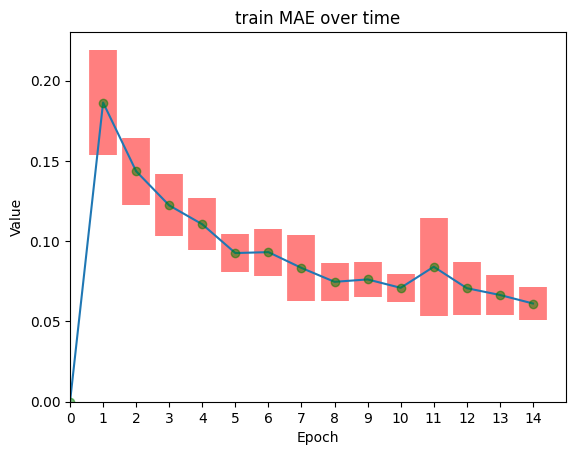

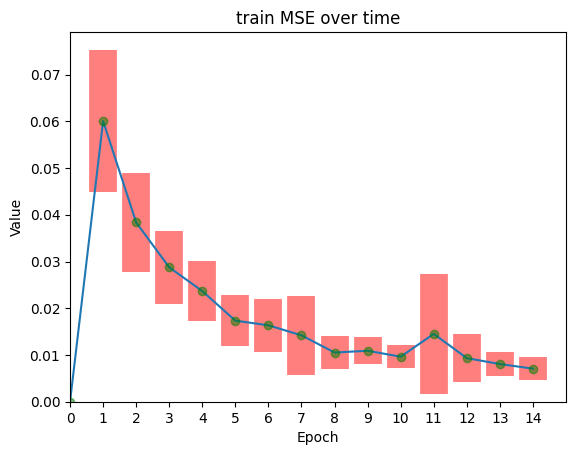

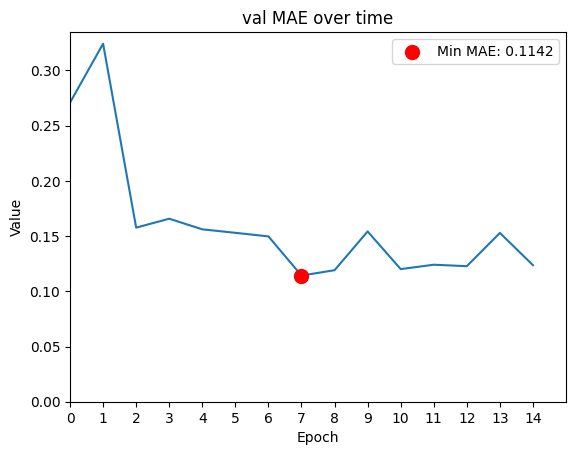

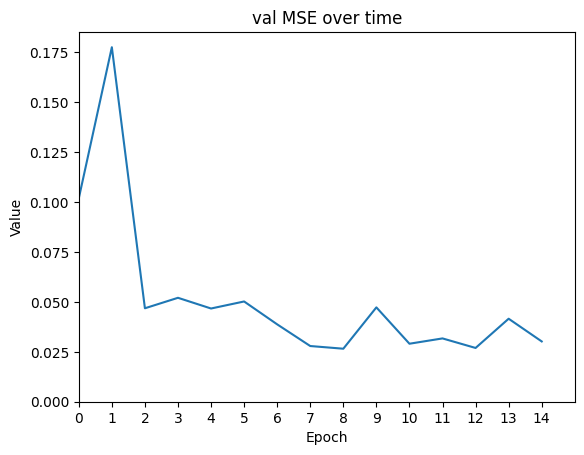

In [ ]:
plot_metrics_history('history5v1.pkl')


Test MAE: 0.1067
Test MSE: 0.0237


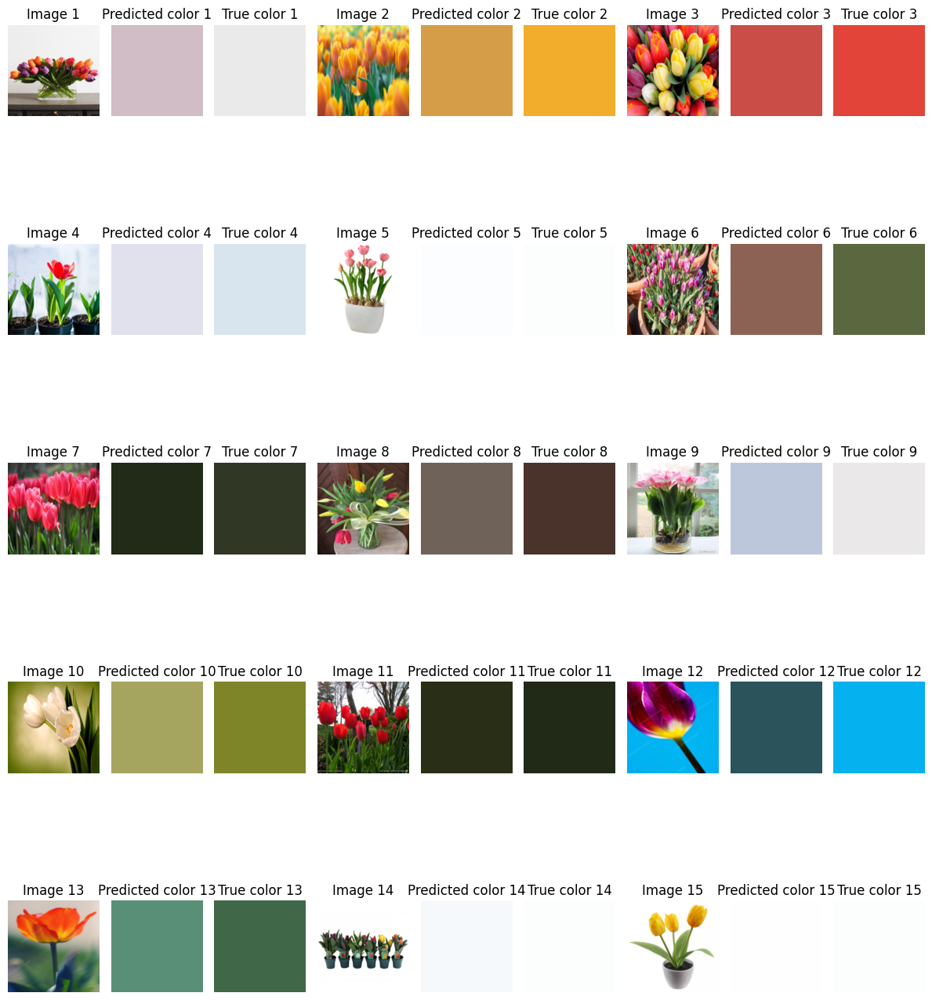

In [ ]:
plot_images_with_predictions(model_5v1, test_loader)

### 2.4.2 Modified ResNet V2

#### Building

In [19]:
class ModifiedResNet2(BasicCNN):
    def __init__(self, freeze_up_to="layer2"):

        super(ModifiedResNet2, self).__init__()
        # Load ResNet
        self.base = models.resnet18(weights='DEFAULT')
        self.base.avgpool = nn.Identity()
        self.base.fc = nn.Identity()

        # Add Squeeze-and-Excitation layers
        self.se1 = SqueezeAndExcitation(in_channels=512)
        self.se2 = SqueezeAndExcitation(in_channels=512)

        self.pool = nn.AdaptiveAvgPool2d((1, 1))

        self.dropout = nn.Dropout(.4)

        # Fully connected layers
        self.fc = nn.Sequential(
            nn.Dropout(.3),
            nn.Linear(512, 3)
        )

        # Freeze layers up to the specified layer
        freeze = True
        for name, param in self.base.named_parameters():
            if freeze:
                param.requires_grad = False
            if freeze_up_to in name:
                freeze = False

    def forward(self, x):
        # Pass through ResNet base
        x = self.base.conv1(x)
        x = self.base.bn1(x)
        x = self.base.relu(x)
        x = self.base.maxpool(x)

        x = self.base.layer1(x)
        x = self.base.layer2(x)
        x = self.base.layer3(x)
        x = self.base.layer4(x)

        # Apply squeeze-and-excitation
        x = self.se1(x)

        x = self.dropout(x)

        x = self.se2(x)

        x = self.pool(x)

        # Global average pooling
        x = torch.flatten(x, 1)


        # Fully connected layers
        x = self.fc(x)

        return torch.sigmoid(x)


#### Training

In [21]:
model_5v2 = ModifiedResNet2().to(device)
optimizer = torch.optim.Adam(model_5v2.parameters(), lr=0.001)

history_5v2 = train_model(model_5v2, 30, optimizer, 7, 'model5v2', 'history5v2.pkl')

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 158MB/s]



Validation Results - MAE: 0.271213561296463, MSE: 0.09800605103373528

Train Epoch: 1:
	Batch: 1: [0/478 (0%)]	Loss: 0.298953
	Batch: 2: [32/478 (7%)]	Loss: 0.274761
	Batch: 3: [64/478 (13%)]	Loss: 0.237537
	Batch: 4: [96/478 (20%)]	Loss: 0.173775
	Batch: 5: [128/478 (27%)]	Loss: 0.199649
	Batch: 6: [160/478 (33%)]	Loss: 0.198094
	Batch: 7: [192/478 (40%)]	Loss: 0.179095
	Batch: 8: [224/478 (47%)]	Loss: 0.169906
	Batch: 9: [256/478 (53%)]	Loss: 0.170621
	Batch: 10: [288/478 (60%)]	Loss: 0.157987
	Batch: 11: [320/478 (67%)]	Loss: 0.154446
	Batch: 12: [352/478 (73%)]	Loss: 0.185947
	Batch: 13: [384/478 (80%)]	Loss: 0.165106
	Batch: 14: [416/478 (87%)]	Loss: 0.172065
	Batch: 15: [420/478 (93%)]	Loss: 0.196500

Validation Results - MAE: 0.29698823392391205, MSE: 0.15443388372659683

Train Epoch: 2:
	Batch: 1: [0/478 (0%)]	Loss: 0.153336
	Batch: 2: [32/478 (7%)]	Loss: 0.145093
	Batch: 3: [64/478 (13%)]	Loss: 0.138904
	Batch: 4: [96/478 (20%)]	Loss: 0.146876
	Batch: 5: [128/478 (27%)]	Loss:

#### Plot results

In [22]:
model_5v2 = ModifiedResNet2().to(device)
model_5v2.load_state_dict(torch.load('model5v2', weights_only=True, map_location=device))

<All keys matched successfully>

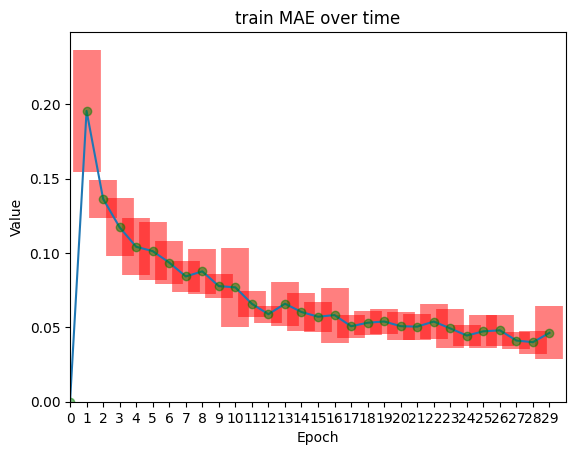

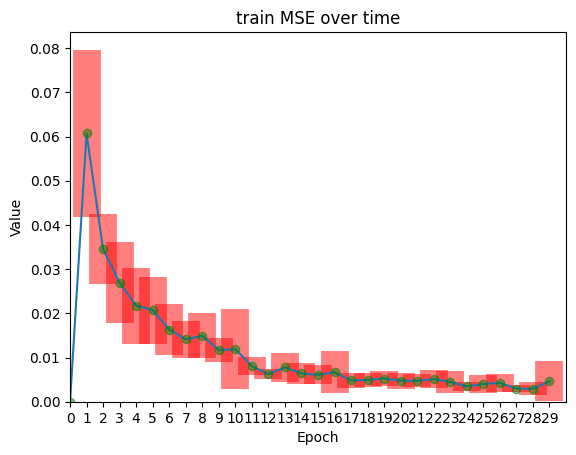

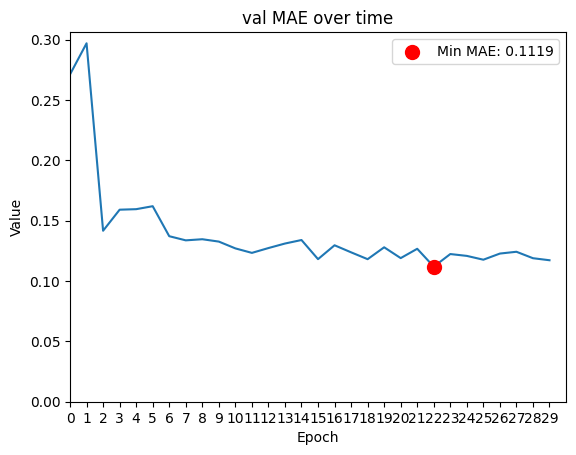

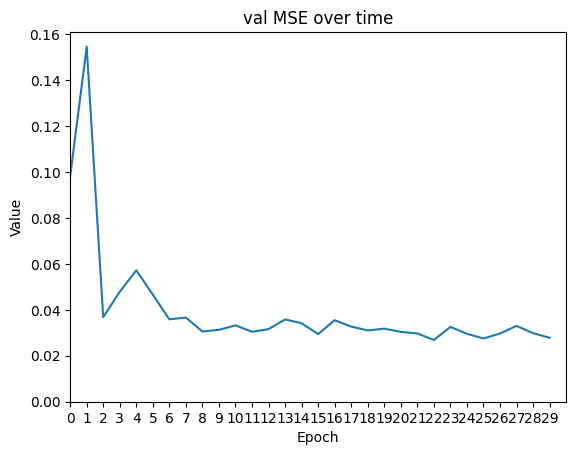

In [23]:
plot_metrics_history('history5v2.pkl')


Test MAE: 0.1055
Test MSE: 0.0231


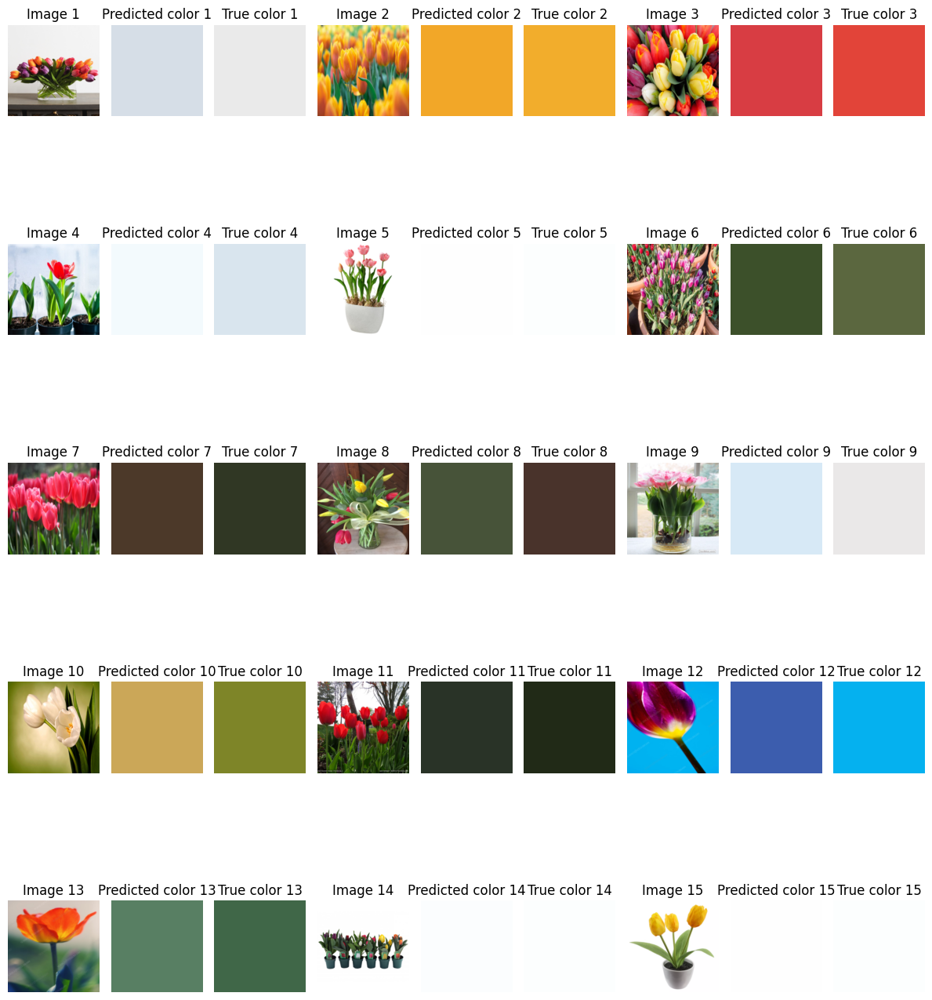

In [24]:
plot_images_with_predictions(model_5v2, test_loader)

## V3

In [27]:
def train_model_2(model, epochs, optimizer, scheduler, early_stopping_patience=7,
                  writer=None, model_save_fname=None, history_save_fpath=None):
    metrics_dict = {
        'train': {
            'MAE': {'stds': [0], 'vals': [0]},
            'MSE': {'stds': [0], 'vals': [0]}
        },
        'val': {
            'MAE': [],
            'MSE': [],
        }
    }

    model.vval(val_loader, metrics_dict)

    best_loss = metrics_dict['val']['MAE'][-1]
    epochs_without_improvement = 0

    # Unfreeze all layers
    for param in model.parameters():
        param.requires_grad = True

    for epoch in range(1, epochs + 1):
        model.ttrain(train_loader, epoch, metrics_dict, optimizer)
        model.vval(val_loader, metrics_dict)

        current_loss = metrics_dict['val']['MAE'][-1]

        # TensorBoard logging for training and validation MAE and MSE
        if writer:
            writer.add_scalar('MAE/train', metrics_dict['train']['MAE']['vals'][-1], epoch)
            writer.add_scalar('MSE/train', metrics_dict['train']['MSE']['vals'][-1], epoch)
            writer.add_scalar('MAE/val', metrics_dict['val']['MAE'][-1], epoch)
            writer.add_scalar('MSE/val', metrics_dict['val']['MSE'][-1], epoch)

        if current_loss < best_loss:
            print("New best loss reached!\n")
            best_loss = current_loss
            epochs_without_improvement = 0
            if model_save_fname:
                torch.save(model.state_dict(), model_save_fname)
        else:
            epochs_without_improvement += 1

        # Scheduler step
        scheduler.step(current_loss)
        print(f"Learning rate = {scheduler.get_last_lr()}\n")

        if epochs_without_improvement >= early_stopping_patience:
            print(f"Early stopping for unfrozen training at epoch {epoch}. No improvement in validation MAE for {early_stopping_patience} consecutive epochs.")
            break

    if history_save_fpath:
        with open(history_save_fpath, 'wb') as f:
            pickle.dump(metrics_dict, f)

    if writer:
        writer.flush()
        writer.close()

    return metrics_dict


#### Building

#### Training

In [29]:
model_5v3 = ModifiedResNet2().to(device)
model_5v3.load_state_dict(torch.load('model5v2', weights_only=True, map_location=device))

optimizer = torch.optim.AdamW(model_5v3.parameters(), lr=1e-4)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=.1, patience=3, threshold=0.00005)
writer = SummaryWriter()

history_5v3 = train_model_2(model=model_5v3, epochs=30, optimizer=optimizer,
                            scheduler=scheduler, early_stopping_patience=7,
                            writer=writer, model_save_fname='model5v3',
                            history_save_fpath='history5v3.pkl')



Validation Results - MAE: 0.11190488934516907, MSE: 0.02685712929815054

Train Epoch: 1:
	Batch: 1: [0/478 (0%)]	Loss: 0.045598
	Batch: 2: [32/478 (7%)]	Loss: 0.059977
	Batch: 3: [64/478 (13%)]	Loss: 0.034976
	Batch: 4: [96/478 (20%)]	Loss: 0.059424
	Batch: 5: [128/478 (27%)]	Loss: 0.045605
	Batch: 6: [160/478 (33%)]	Loss: 0.050030
	Batch: 7: [192/478 (40%)]	Loss: 0.032444
	Batch: 8: [224/478 (47%)]	Loss: 0.037190
	Batch: 9: [256/478 (53%)]	Loss: 0.031597
	Batch: 10: [288/478 (60%)]	Loss: 0.040502
	Batch: 11: [320/478 (67%)]	Loss: 0.033132
	Batch: 12: [352/478 (73%)]	Loss: 0.050790
	Batch: 13: [384/478 (80%)]	Loss: 0.053705
	Batch: 14: [416/478 (87%)]	Loss: 0.046999
	Batch: 15: [420/478 (93%)]	Loss: 0.035326

Validation Results - MAE: 0.11632559821009636, MSE: 0.030086088925600052

Learning rate = [0.0001]

Train Epoch: 2:
	Batch: 1: [0/478 (0%)]	Loss: 0.041303
	Batch: 2: [32/478 (7%)]	Loss: 0.047042
	Batch: 3: [64/478 (13%)]	Loss: 0.038728
	Batch: 4: [96/478 (20%)]	Loss: 0.037587
	Ba

In [30]:
model_5v3 = ModifiedResNet2().to(device)
model_5v3.load_state_dict(torch.load('model5v3', weights_only=True, map_location=device))

<All keys matched successfully>

#### Plot results

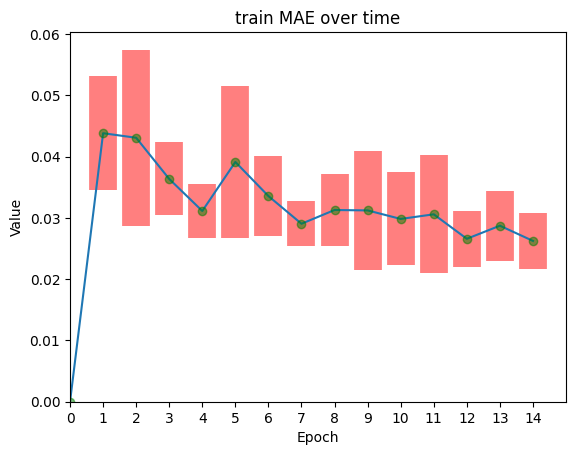

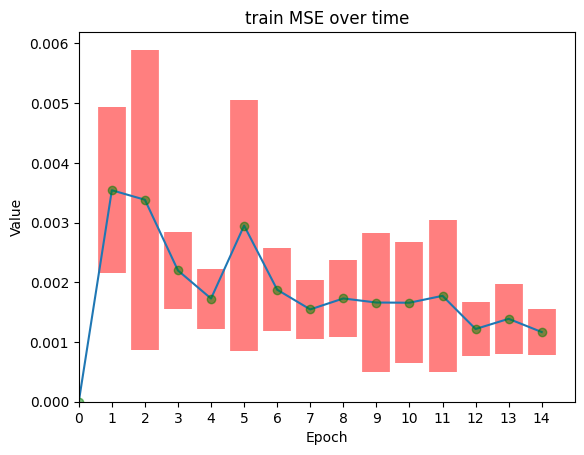

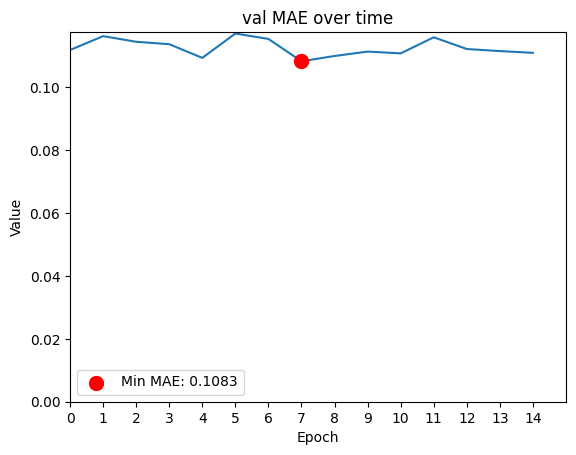

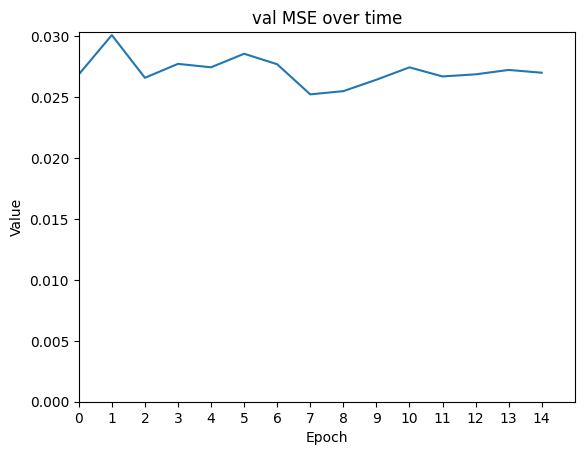

In [31]:
plot_metrics_history('history5v3.pkl')


Test MAE: 0.0990
Test MSE: 0.0193


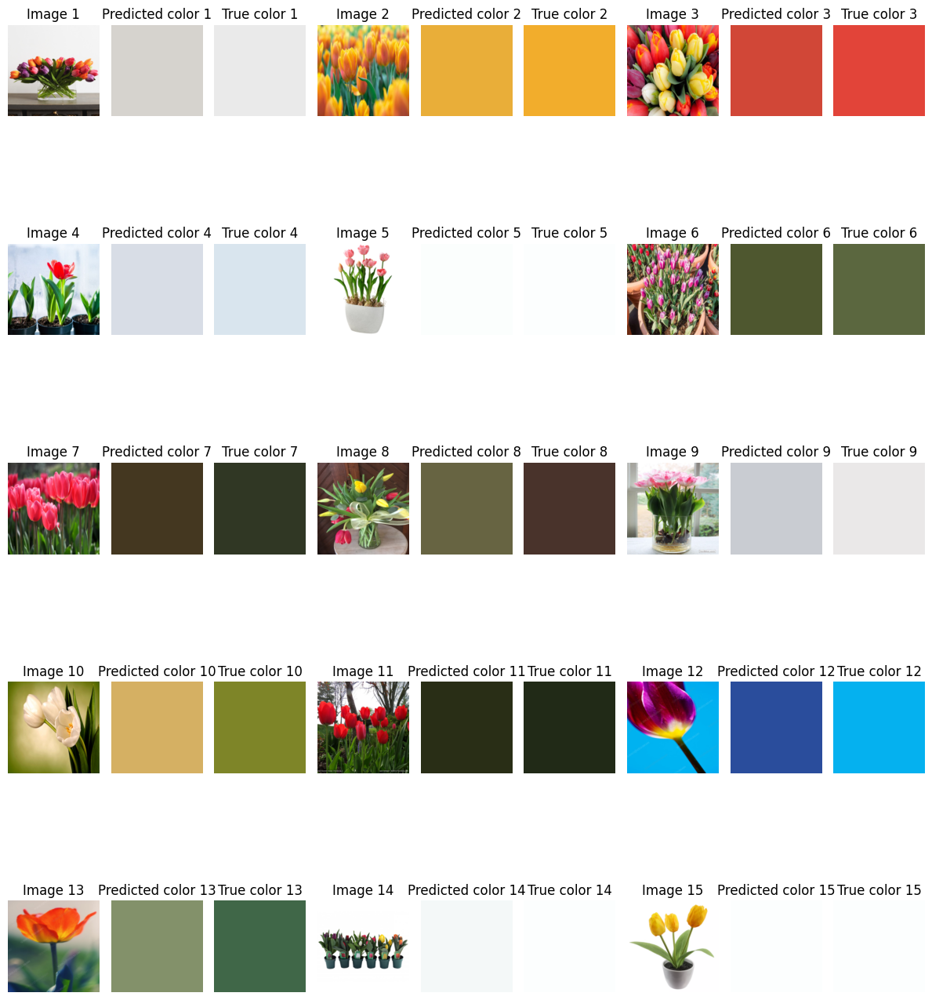

In [32]:
plot_images_with_predictions(model_5v3, test_loader)

In [33]:
%tensorboard --logdir=runs

<IPython.core.display.Javascript object>

# 3. Error Analysis

In [34]:
model_5v3 = ModifiedResNet2().to(device)
model_5v3.load_state_dict(torch.load('model5v3', weights_only=True, map_location=device))

<All keys matched successfully>

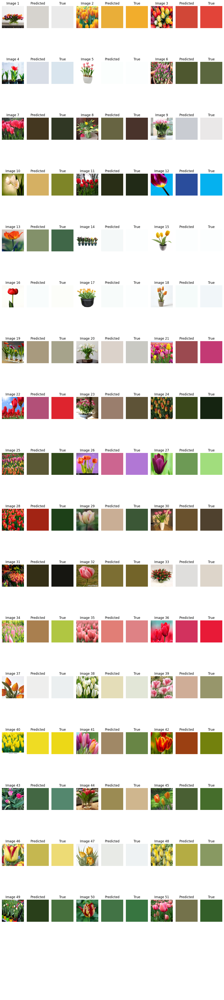

In [56]:
plot_images_with_predictions(model_5v3, test_loader, n_rows=18)

In [71]:
def error_analysis(model, test_loader, indices_to_analyze):
    model.eval()  # Set model to evaluation mode
    analyzed_indices = set()
    current_index = 0  # Global index tracking across batches

    with torch.no_grad():
        for images, labels in test_loader:
            images, labels = images.to(device), labels.to(device)
            batch_size = images.size(0)

            # Loop through batch
            for i in range(batch_size):
                if current_index + 1 in indices_to_analyze:
                    # Extract image, predicted color, and true color
                    img_rgb = images[i].cpu().permute(1, 2, 0).numpy()
                    img_rgb = img_rgb[..., ::-1]  # Convert from BGR to RGB
                    predicted_rgb = model(images[i:i+1]).cpu().numpy().clip(0, 1)[0]
                    true_rgb = labels[i].cpu().numpy().clip(0, 1)

                    # Print predicted and true colors
                    print(f"Sample Index {current_index + 1}:")
                    print(f"  Predicted RGB: {predicted_rgb*255}")
                    print(f"  True RGB: {true_rgb*255}\n")

                    # Plot the image alongside predicted and true colors
                    fig, axs = plt.subplots(1, 3, figsize=(6, 3))

                    axs[0].imshow(img_rgb)
                    axs[0].set_title(f"Image Index {current_index + 1}")
                    axs[0].axis('off')

                    axs[1].imshow([[predicted_rgb]])
                    axs[1].set_title("Predicted Color")
                    axs[1].axis('off')

                    axs[2].imshow([[true_rgb]])
                    axs[2].set_title("True Color")
                    axs[2].axis('off')

                    plt.tight_layout()
                    plt.show()

                    analyzed_indices.add(current_index)

                # Stop if all specified indices have been analyzed
                if len(analyzed_indices) == len(indices_to_analyze):
                    return

                current_index += 1


Sample Index 7:
  Predicted RGB: [68.63787  55.01551  32.905968]
  True RGB: [48. 55. 36.]



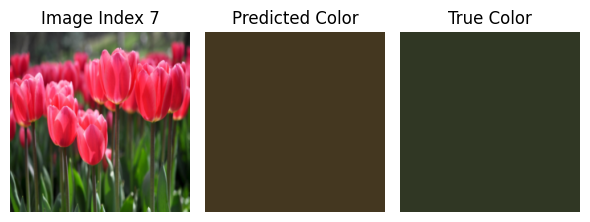

Sample Index 8:
  Predicted RGB: [103.02346 100.49259  66.9152 ]
  True RGB: [73. 51. 43.]



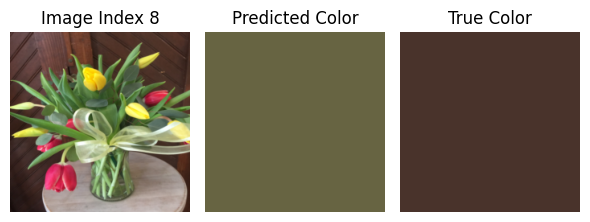

Sample Index 10:
  Predicted RGB: [213.7743  176.76732  99.83876]
  True RGB: [126. 133.  40.]



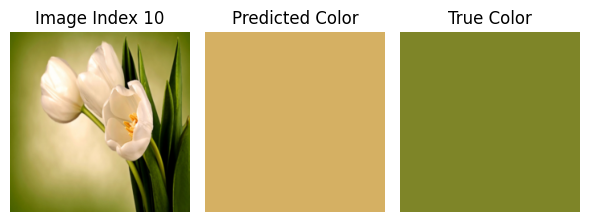

Sample Index 12:
  Predicted RGB: [ 42.08458  77.81354 156.59605]
  True RGB: [  5. 177. 239.]



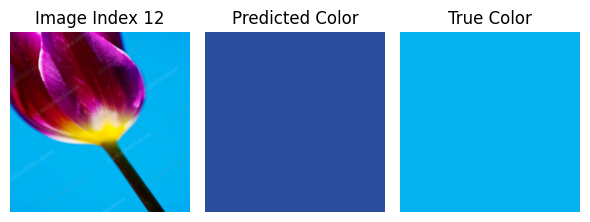

Sample Index 13:
  Predicted RGB: [131.63657 145.73206 106.56355]
  True RGB: [ 64. 103.  72.]



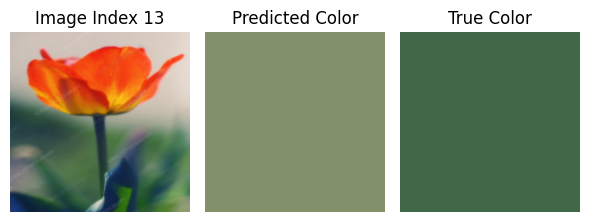

Sample Index 21:
  Predicted RGB: [155.77971  74.91526  80.39405]
  True RGB: [195.  57. 116.]



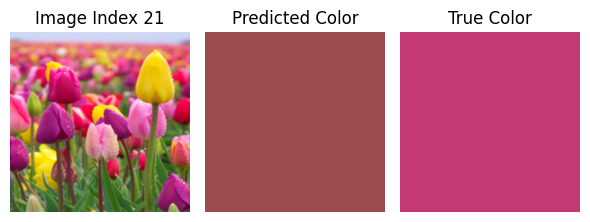

Sample Index 22:
  Predicted RGB: [178.84424  80.57907 120.47087]
  True RGB: [222.  36.  46.]



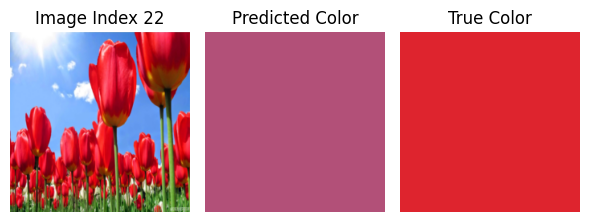

Sample Index 23:
  Predicted RGB: [154.06316  126.488434 109.41454 ]
  True RGB: [94. 83. 55.]



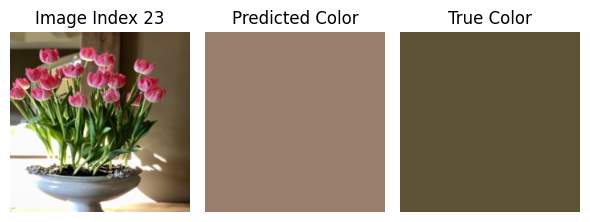

Sample Index 25:
  Predicted RGB: [91.79685  88.51148  53.370483]
  True RGB: [49. 74. 27.]



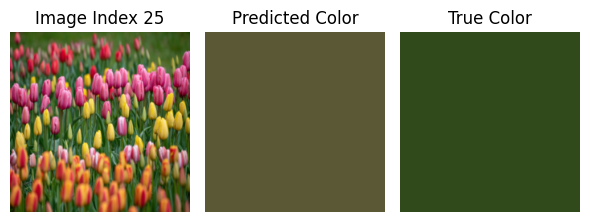

Sample Index 26:
  Predicted RGB: [204.15694 101.11625 144.04254]
  True RGB: [177. 119. 213.]



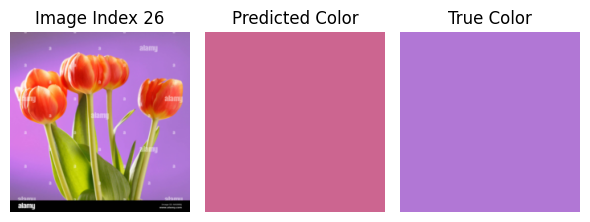

Sample Index 34:
  Predicted RGB: [169.81764  127.82964   79.407265]
  True RGB: [176. 198.  66.]



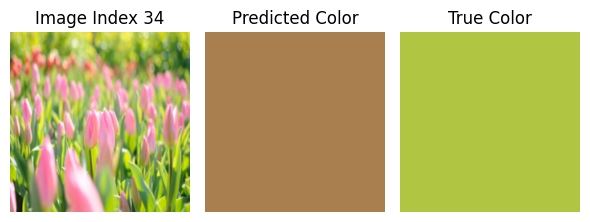

Sample Index 38:
  Predicted RGB: [228.34456 221.96951 184.2407 ]
  True RGB: [226. 230. 215.]



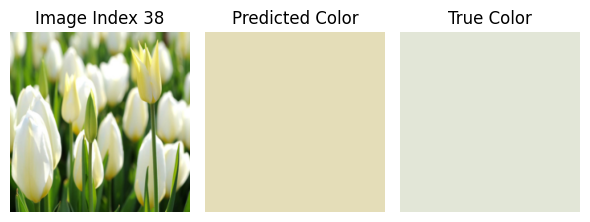

Sample Index 39:
  Predicted RGB: [207.32736 173.07353 151.63814]
  True RGB: [151. 150. 107.]



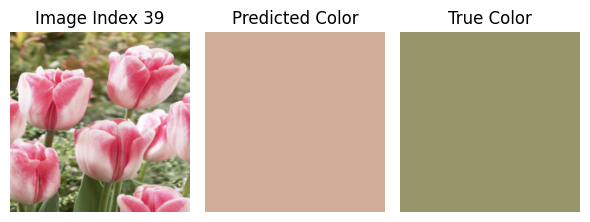

Sample Index 41:
  Predicted RGB: [160.33261 136.30746 102.95501]
  True RGB: [104. 133.  69.]



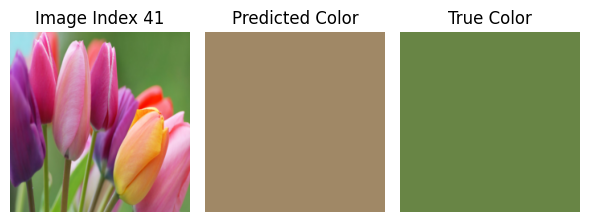

Sample Index 51:
  Predicted RGB: [116.75075 114.71659  75.36526]
  True RGB: [51. 95. 41.]



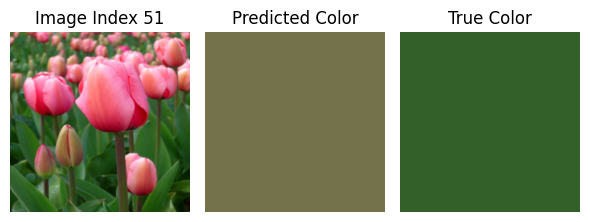

In [73]:
error_analysis(model=model_5v3, test_loader=test_loader, indices_to_analyze=[7, 8, 10, 12, 13, 21, 22, 23, 25, 26, 34, 38, 39, 41, 51])

The most common issue appears to occur with images containing multiple colors, where the model tends to predict a dominant color that resembles a mix of the most prominent colors in the image. The model will most likely benefit from more data of images like this.

Sample Index 28:
  Predicted RGB: [162.69734   36.066296  20.344795]
  True RGB: [29. 64. 24.]



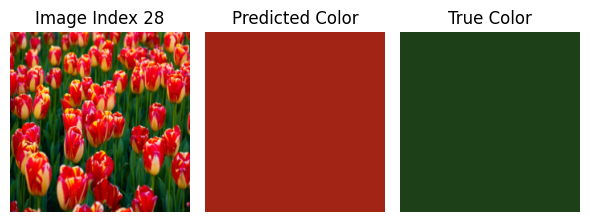

Sample Index 29:
  Predicted RGB: [201.84914 174.33917 149.78856]
  True RGB: [59. 87. 54.]



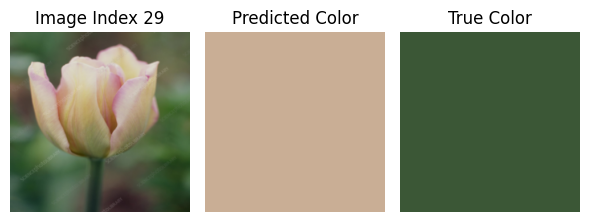

Sample Index 42:
  Predicted RGB: [155.3065   64.64719  18.38854]
  True RGB: [115. 129.  13.]



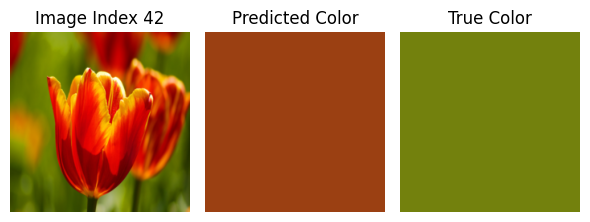

Sample Index 48:
  Predicted RGB: [180.29787 172.4527   68.46756]
  True RGB: [136. 153.  98.]



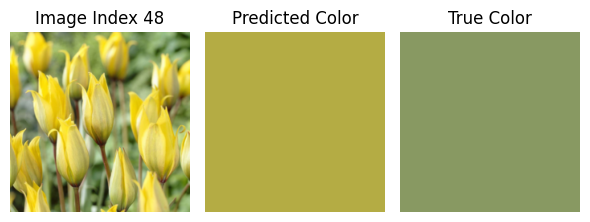

In [74]:
error_analysis(model=model_5v3, test_loader=test_loader, indices_to_analyze=[28, 29, 42, 48])

The model sometimes predicts the other dominant color as the dominant color. This usually happens when there are two colors that seem dominant. These predictions don't seem neccesarily wrong, since there can be multiple colors that could be labeled as the correct dominant color.